In [1]:
import numpy as np
import matplotlib.pyplot as plt
import _pickle as pkl
import pandas as pd
import os,sys,glob, h5py

from dlab import generalephys as ephys
from dlab.generalephys import placeAxesOnGrid, cleanAxes
from dlab import utils
from dlab import rf_analysis
from dlab import psth_and_raster as psth
from dlab import reliability_and_precision as rp
from dlab.continuous_traces import gaussian_filter1d
from scipy.signal import find_peaks
from scipy.stats import pearsonr, spearmanr, zscore
from itertools import combinations
from dlab import outcome


from dlab import analysis_pipeline as analysis





from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import seaborn as sns
sns.set_style('white')
%matplotlib inline
%load_ext autoreload
%autoreload 2
import warnings
warnings.filterwarnings('ignore')

In [2]:
def center(X):
    # X: ndarray, shape (n_features, n_samples)
    ss = StandardScaler(with_mean=True, with_std=True)
    Xc = ss.fit_transform(X.T).T
    return Xc



def pca(tens):
    for i in range(min(tens.shape[0], tens.shape[1])-1):
        pca = PCA(n_components=i)
        p=pca.fit_transform(tens.T).T
        ev = (pca.explained_variance_ / sum(pca.explained_variance_))
    return p,ev

In [3]:
path = '/Users/kimberlygagnon/Documents/code/python/pipeline_final/USE_THIS_DATA'
df = pd.read_json(os.path.join(path,'df_all_mice_09_24_21.json'))
df_reaches = pd.read_json(os.path.join(path,'df_reaches_aligned_092621.json'))
#df_start = pd.read_csv(os.path.join(path,'Neuropixels_ProcessorStartTimes.csv'))
#df_timestamps = pd.read_json(os.path.join(path,'df_timestamps.json'))

#df_sq = pd.read_json('/Users/kimberlygagnon/Documents/CU/WelleLab/code/python/pipeline_final/df_sortinquality_all_mice.json')

# Align

In [4]:
#adds reach max frame to df_reaches
dfs = [analysis.batch_synch_phys(df,df_start,df_reaches,df_timestamps,mouseid,inputs=False) for mouseid in df_timestamps.mouse.unique()]
df_reaches = pd.concat(dfs,ignore_index=True)

mouse: 11
number of timestamps: (1083326,)
removed odd indices
aligned
mouse: 12
number of timestamps: (1083334,)
removed odd indices
aligned
mouse: 18
number of timestamps: (972236,)
removed odd indices
aligned
mouse: 19
number of timestamps: (1083330,)
removed odd indices
aligned
mouse: 20
number of timestamps: (1059120,)
removed odd indices
aligned
mouse: 21
number of timestamps: (1083330,)
removed odd indices
aligned
mouse: 22
number of timestamps: (180634,)
aligned
mouse: 24
number of timestamps: (1083374,)
removed odd indices
aligned
mouse: 25
number of timestamps: (328286,)
FRAME TIMESTAMPS DO NOT ALIGN WITH BEHAVIOR 25!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
mouse: 26
number of timestamps: (541644,)
aligned
mouse: 28
number of timestamps: (315846,)
aligned
mouse: 34
number of timestamps: (5350,)
aligned
mouse: 42
number of timestamps: (265138,)
aligned
mouse: 43
number of timestamps: (289572,)
aligned
mouse: 47
number of timestamps: (1083264,)
removed odd indices
aligned
mouse: 

creating heatmap for 11.....
movement modulated units found
plotting heatmap


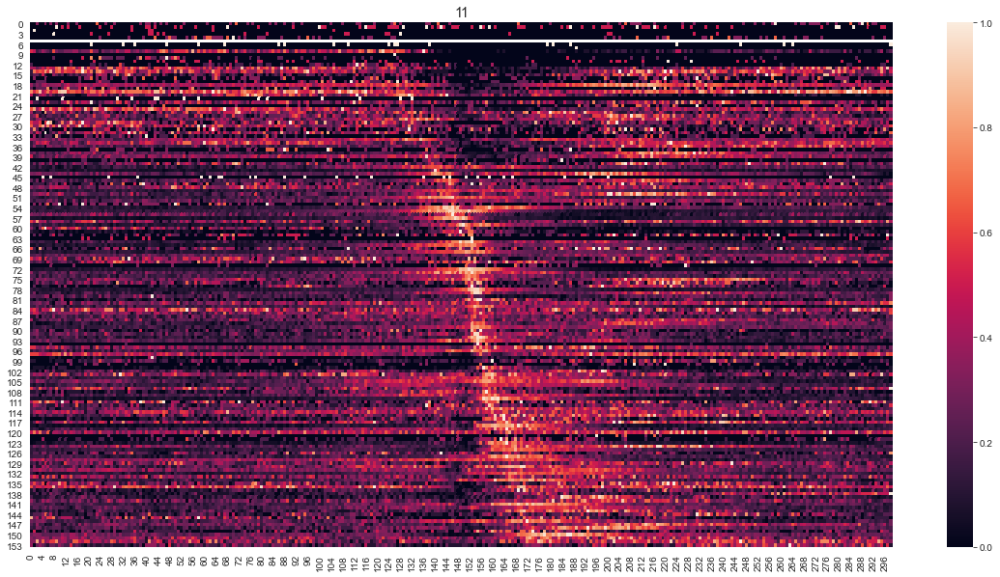

creating heatmap for 12.....
movement modulated units found
plotting heatmap


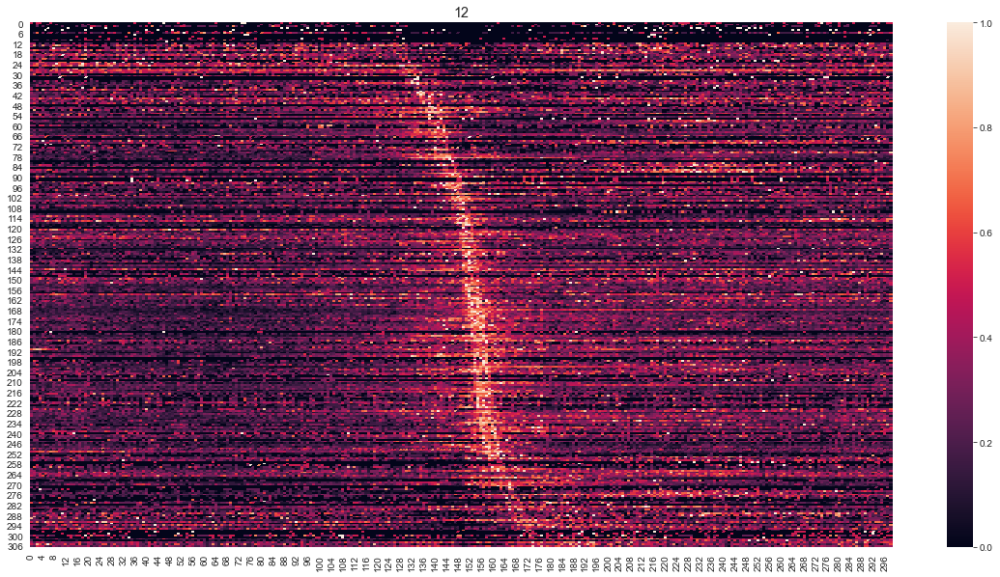

creating heatmap for 18.....
movement modulated units found
plotting heatmap


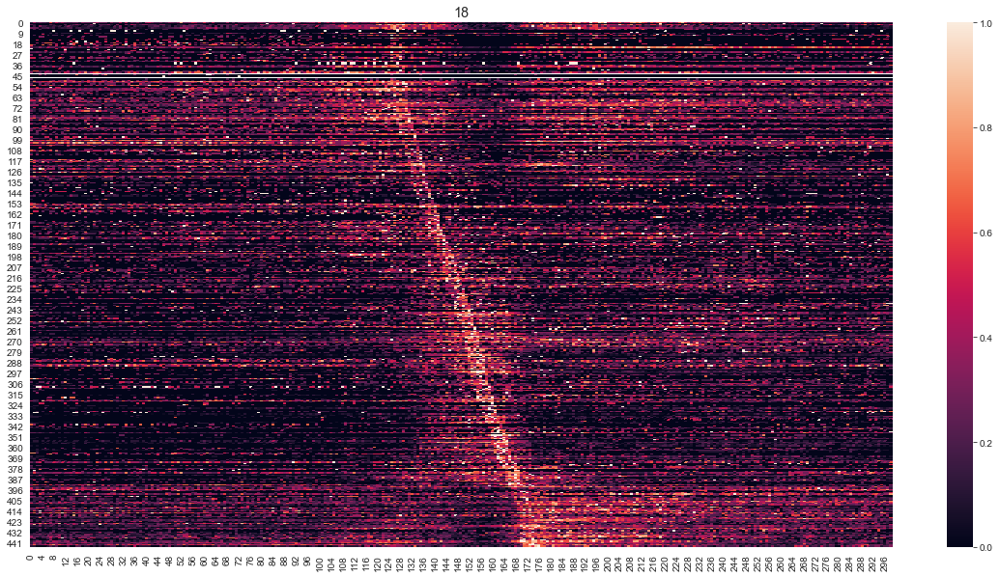

creating heatmap for 19.....
movement modulated units found
plotting heatmap


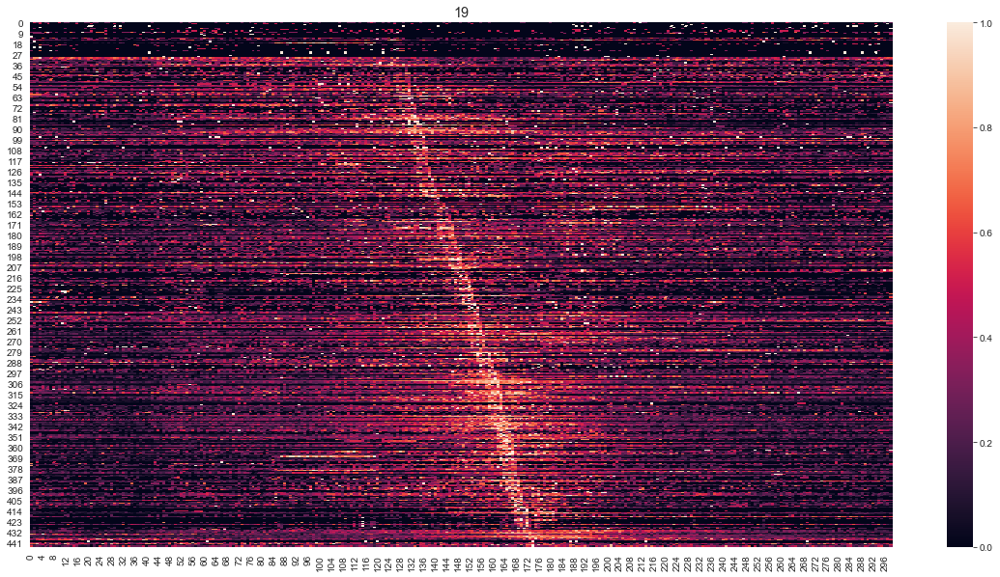

creating heatmap for 20.....
movement modulated units found
plotting heatmap


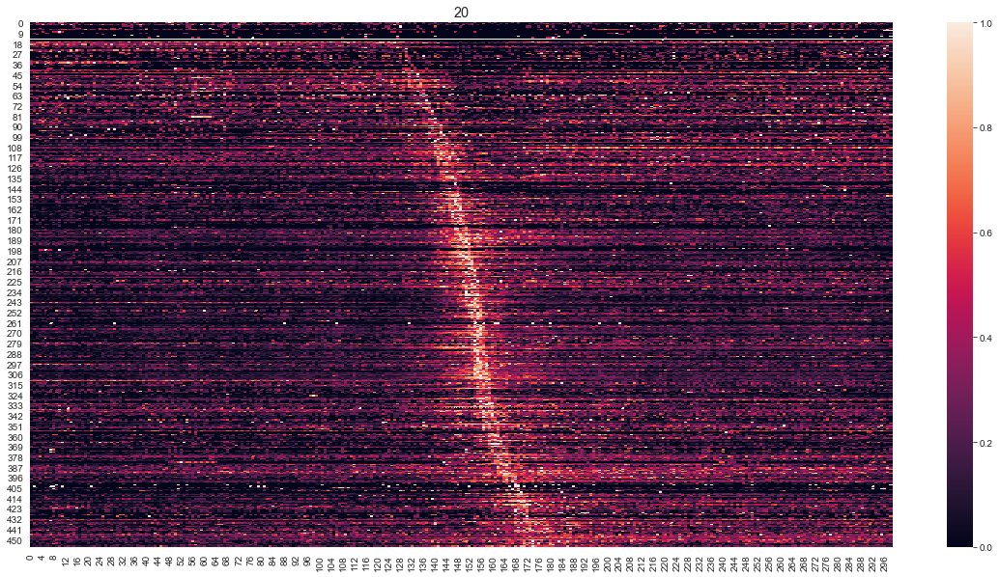

creating heatmap for 21.....
movement modulated units found
plotting heatmap


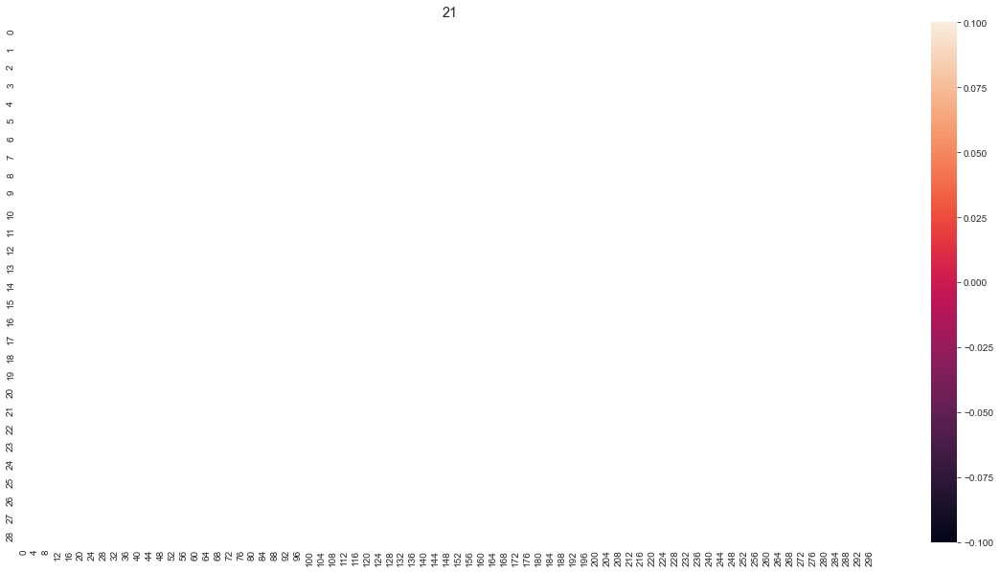

creating heatmap for 22.....
movement modulated units found
plotting heatmap


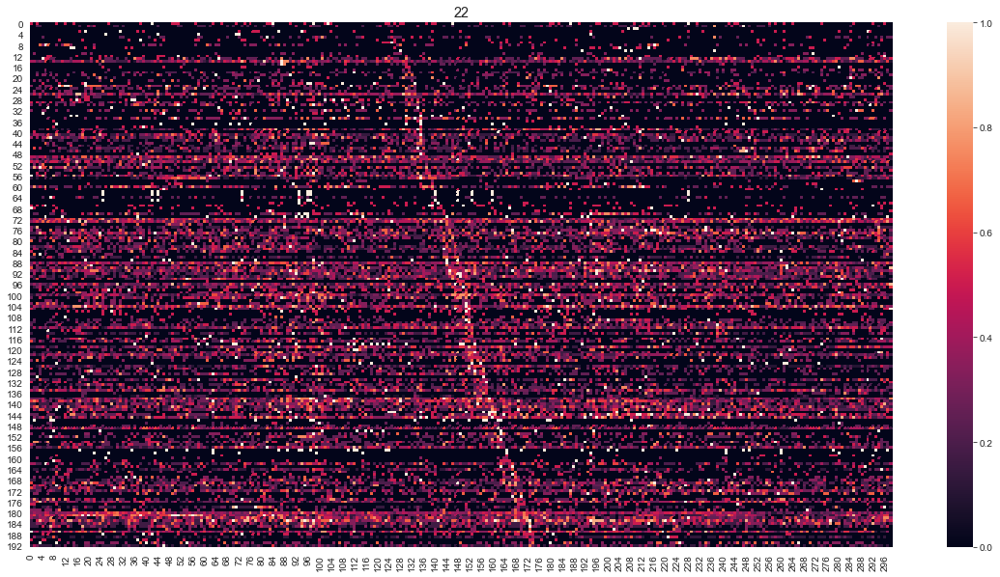

creating heatmap for 24.....
movement modulated units found
plotting heatmap


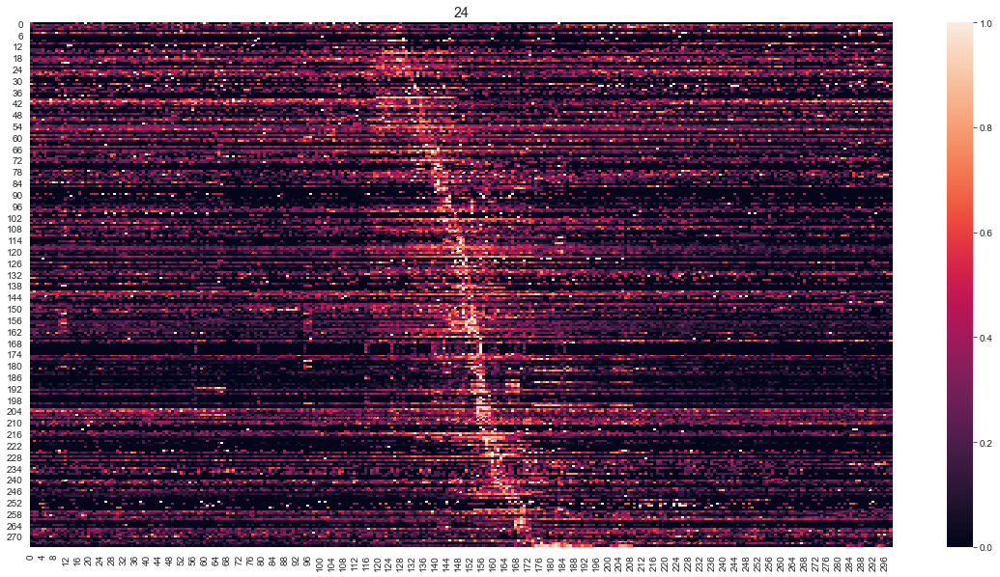

creating heatmap for 42.....
movement modulated units found
plotting heatmap


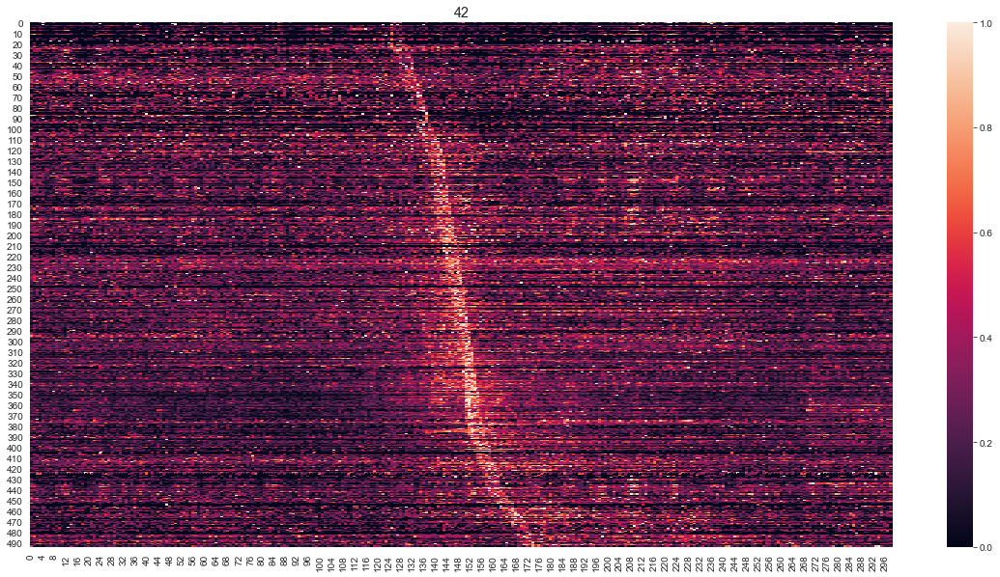

creating heatmap for 43.....
movement modulated units found
plotting heatmap


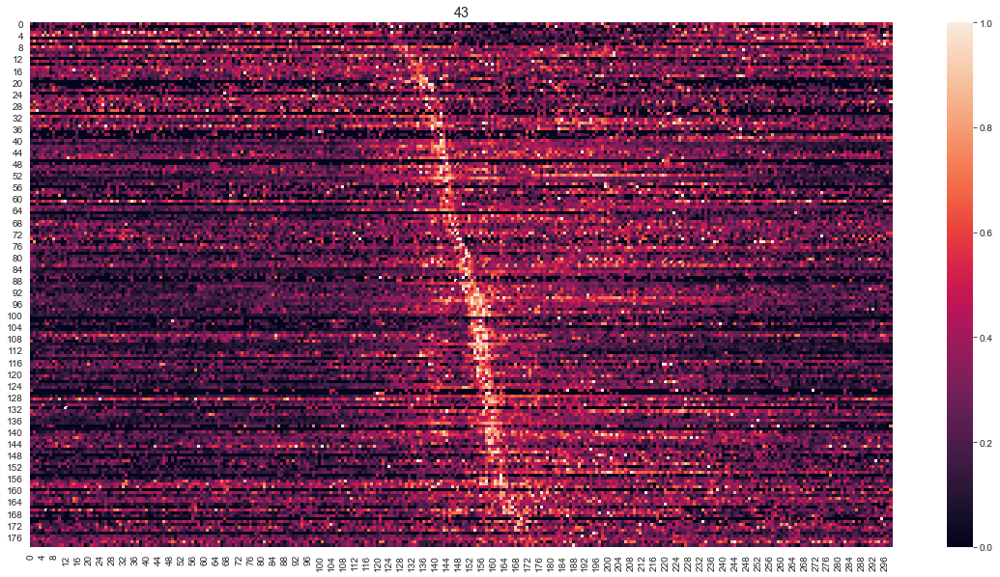

creating heatmap for 47.....
movement modulated units found
plotting heatmap


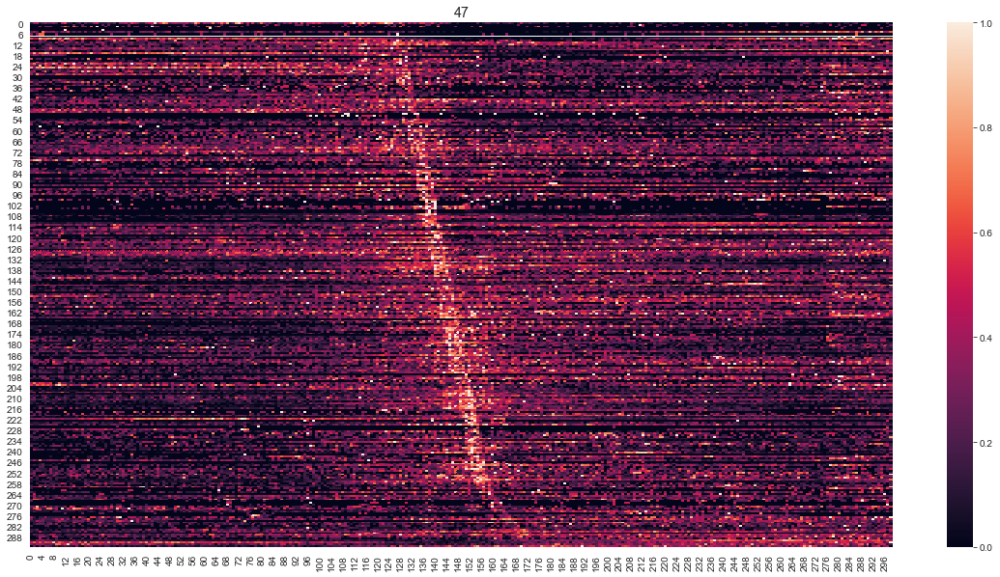

creating heatmap for 50.....
movement modulated units found
plotting heatmap


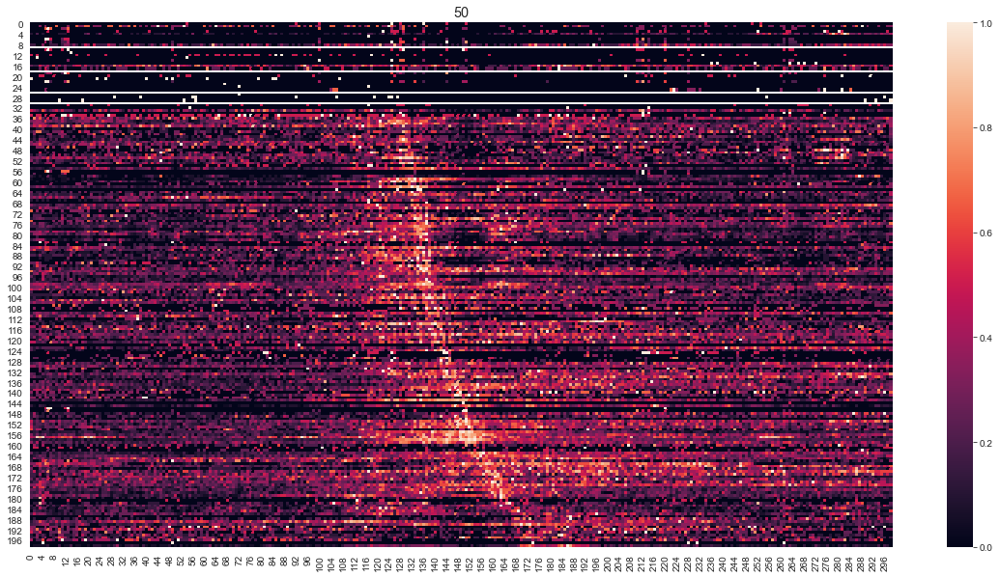

creating heatmap for 51.....
movement modulated units found
plotting heatmap


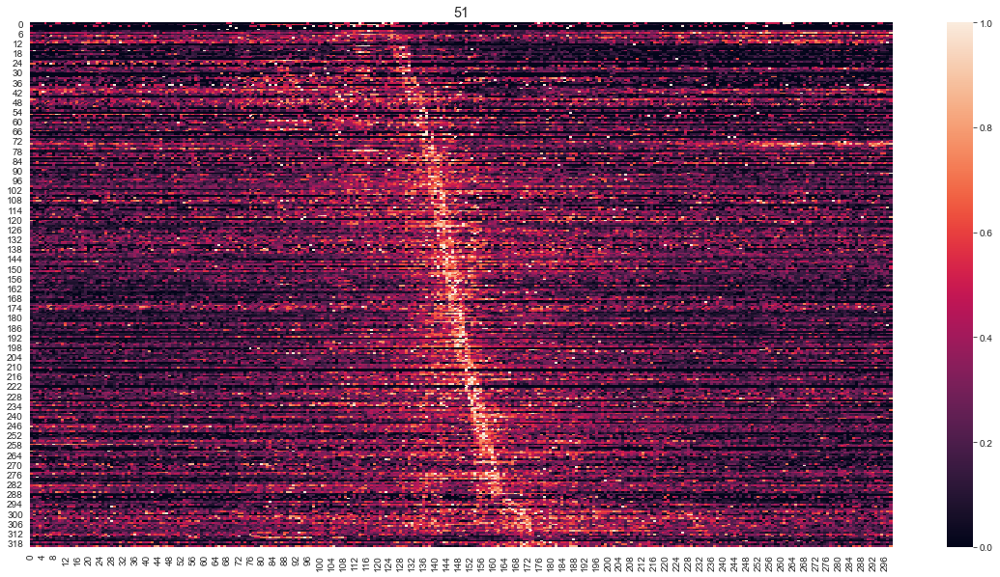

creating heatmap for 53.....
movement modulated units found
plotting heatmap


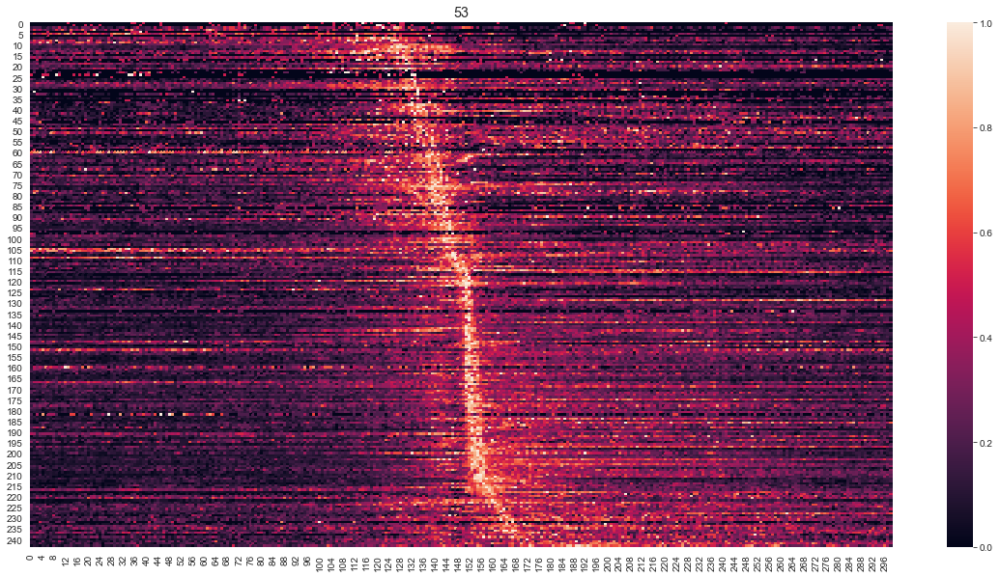

creating heatmap for 56.....
movement modulated units found
plotting heatmap


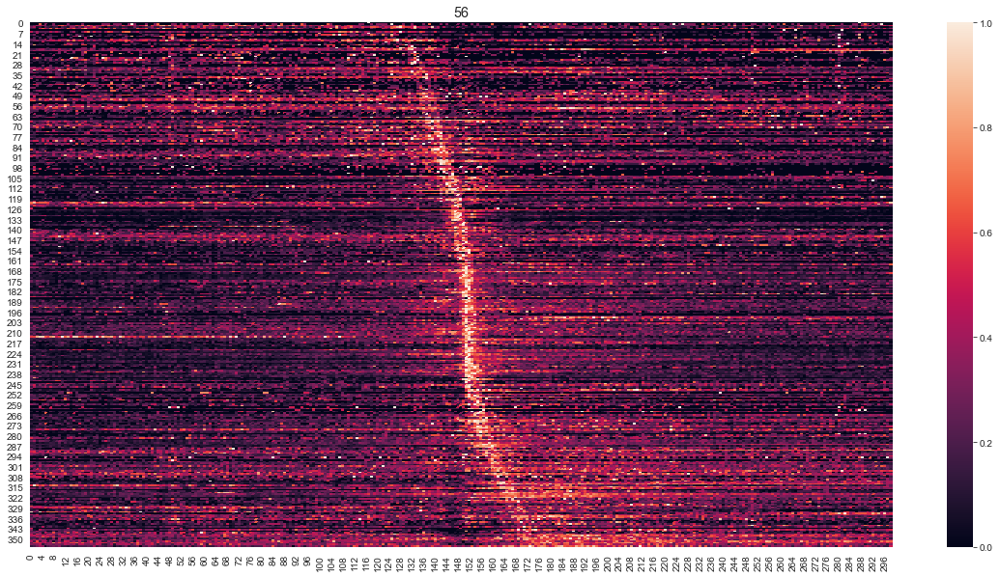

creating heatmap for 58.....
movement modulated units found
plotting heatmap
movement modulation units not found mouse 58
creating heatmap for 66.....
movement modulated units found
plotting heatmap


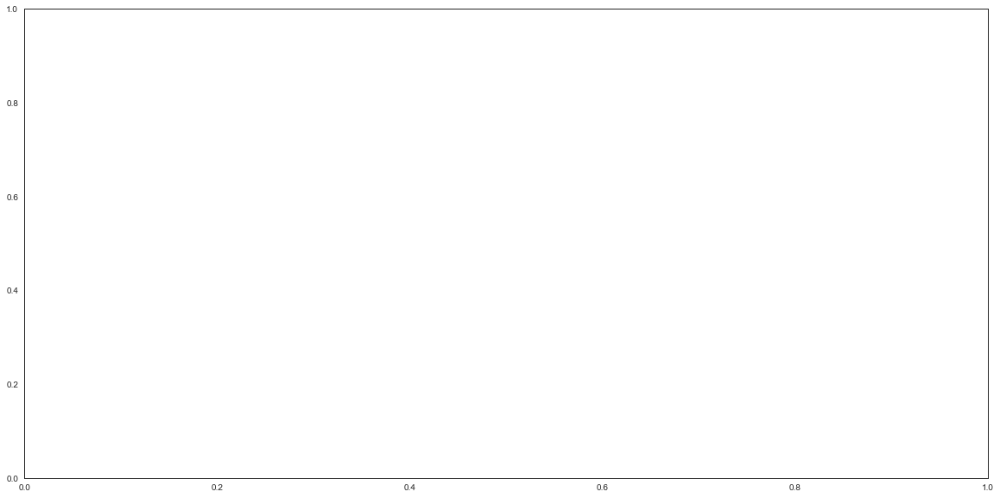

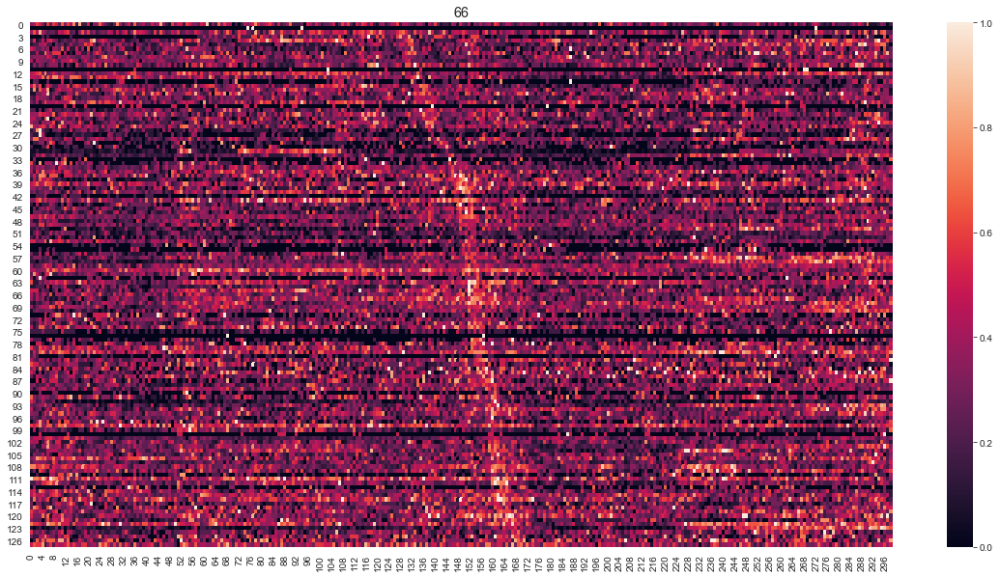

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [129]:
[analysis.trial_ave_heatmap(df,df_reaches,mouseid,binsize=0.020, start = -3.0,end = 3.0) for mouseid in df_reaches.mouse.unique()]

# Preprocessing for SVM

In [5]:
df_ = df
dfr_ = df_reaches

In [6]:
df_reaches = dfr_[dfr_.mouse==51].reset_index()
df = df_[df_.mouse==51].reset_index()

In [57]:
# play with this to find outcome neurons
start = -3
end = 8
binsize = 0.020

In [58]:
each_unit,behavior,units = outcome.create_SVM_values(df,df_reaches,start,end,binsize)

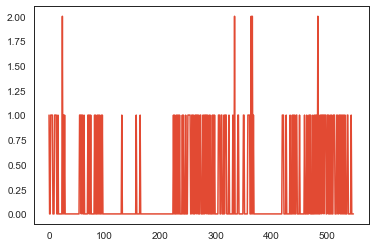

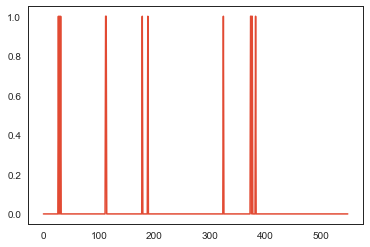

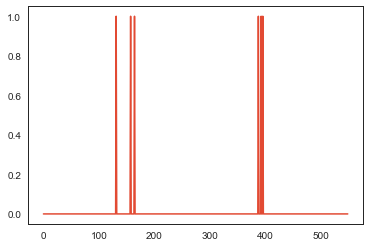

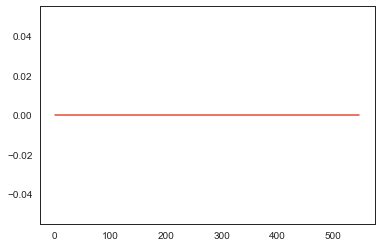

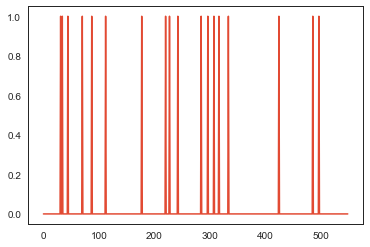

...

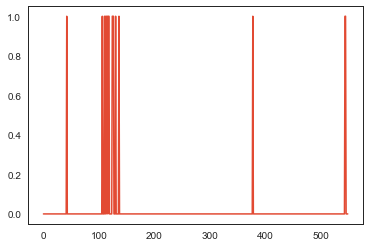

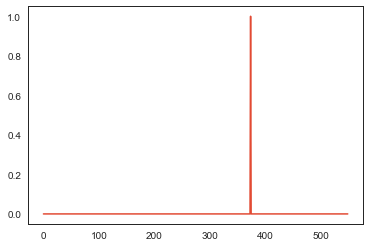

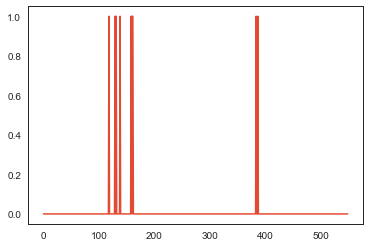

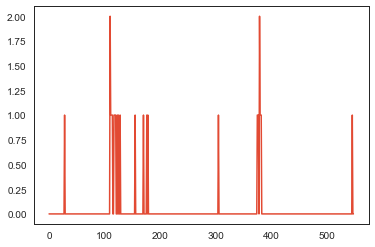

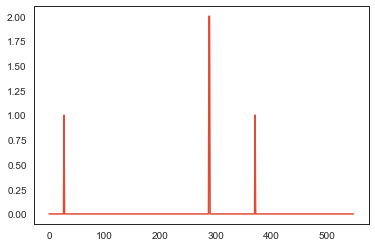

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [176]:
for i in each_unit:
    plt.plot(sum(i,axis=0))
    plt.show()
    plt.close()

# SVM for indicative neurons

In [59]:
param_grid = [
    {'C': [0.5,1,10,100],
    'gamma': ['scale', 1,0.1,0.01,0.001,0.0001],
    'kernel': ['linear']},
]

In [60]:
scores,y_train,y_test = outcome.get_SVM_scores(each_unit,behavior,param_grid)

{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 

{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 10, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}
{'C': 0.5, 'gamma': '

In [16]:
scores = outcome.get_SVM_scores_crossval(each_unit,behavior,param_grid)

0.42 accuracy with a standard deviation of 0.06
0.45 accuracy with a standard deviation of 0.06
0.42 accuracy with a standard deviation of 0.08
0.42 accuracy with a standard deviation of 0.10
0.37 accuracy with a standard deviation of 0.06
0.48 accuracy with a standard deviation of 0.09
0.42 accuracy with a standard deviation of 0.10
0.42 accuracy with a standard deviation of 0.09
0.40 accuracy with a standard deviation of 0.12
0.43 accuracy with a standard deviation of 0.09
0.38 accuracy with a standard deviation of 0.11
0.49 accuracy with a standard deviation of 0.04
0.46 accuracy with a standard deviation of 0.07
0.45 accuracy with a standard deviation of 0.09
0.43 accuracy with a standard deviation of 0.09
0.46 accuracy with a standard deviation of 0.07
0.45 accuracy with a standard deviation of 0.12
0.38 accuracy with a standard deviation of 0.08
0.43 accuracy with a standard deviation of 0.10
0.38 accuracy with a standard deviation of 0.08
0.43 accuracy with a standard deviation 

0.45 accuracy with a standard deviation of 0.09
0.38 accuracy with a standard deviation of 0.08
0.38 accuracy with a standard deviation of 0.08
0.37 accuracy with a standard deviation of 0.12
0.40 accuracy with a standard deviation of 0.11
0.35 accuracy with a standard deviation of 0.06
0.40 accuracy with a standard deviation of 0.06
0.43 accuracy with a standard deviation of 0.06
0.46 accuracy with a standard deviation of 0.10
0.48 accuracy with a standard deviation of 0.09
0.43 accuracy with a standard deviation of 0.04
0.46 accuracy with a standard deviation of 0.07
0.48 accuracy with a standard deviation of 0.06
0.35 accuracy with a standard deviation of 0.09
0.43 accuracy with a standard deviation of 0.09
0.42 accuracy with a standard deviation of 0.12
0.35 accuracy with a standard deviation of 0.08
0.46 accuracy with a standard deviation of 0.07
0.40 accuracy with a standard deviation of 0.03
0.43 accuracy with a standard deviation of 0.06
0.40 accuracy with a standard deviation 

In [28]:
for i in weights:
    plt.scatter(i)

NameError: name 'weights' is not defined

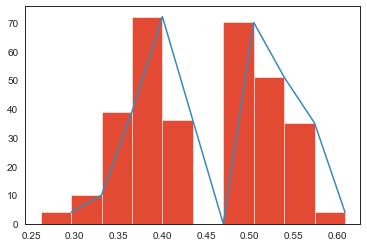

In [49]:
# 47
d = plt.hist(scores,bins=10)
plt.plot(d[1][1:],d[0])

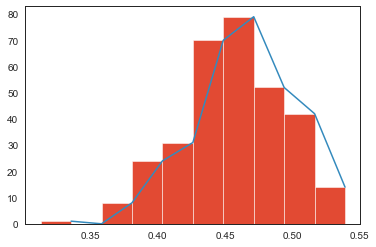

In [143]:
#cross-val: 51

d = plt.hist(scores,bins=10)
plt.plot(d[1][1:],d[0])

0.5227272727272727
0.4782608695652174


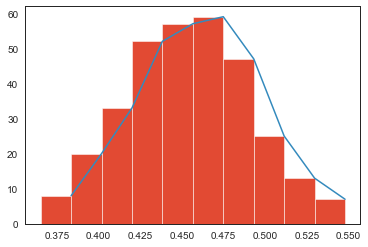

In [133]:
#cross-val:
print(np.mean(y_train))
print(np.mean(y_test))
d = plt.hist(scores,bins=10)
plt.plot(d[1][1:],d[0])

In [113]:
print(np.mean(y_train))
print(np.mean(y_test))

0.48863636363636365
0.6086956521739131


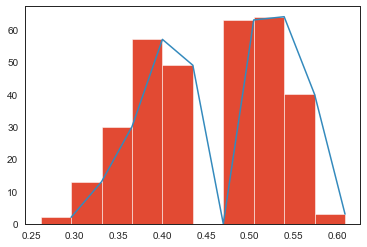

In [114]:
d = plt.hist(scores,bins=10)
plt.plot(d[1][1:],d[0])

In [116]:
print(np.mean(y_train))
print(np.mean(y_test))

0.5
0.5652173913043478


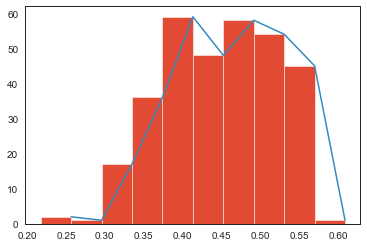

In [117]:
d = plt.hist(scores,bins=10)
plt.plot(d[1][1:],d[0])

In [119]:
print(np.mean(y_train))
print(np.mean(y_test))

0.5227272727272727
0.4782608695652174


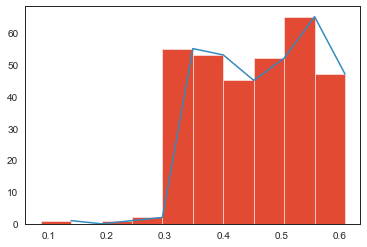

In [120]:
d = plt.hist(scores,bins=10)
plt.plot(d[1][1:],d[0])

0.5
0.38461538461538464


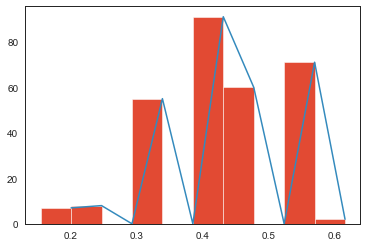

In [192]:
#47
print(np.mean(y_train))
print(np.mean(y_test))
d = plt.hist(scores,bins=10)
plt.plot(d[1][1:],d[0])

# movement modulated manual outcome determination

In [12]:
df = df[df.group=='good']

In [16]:
# manual method

mod_up, mod_down, maxfr_ts, minfr_ts = analysis.movement_mod(df,df_reaches,startb = -2.0,endb = -1.0,starte = 0,ende = 1,binsize=0.001)
df['mod_up'] = mod_up
df['mod_down'] = mod_down
df['peak_up'] = maxfr_ts
df['peak_down'] = minfr_ts

In [17]:
# manual method
df_mov = df[df.mod_up=='yes']

In [18]:
# manual method
indicative_units = df_mov.index

In [19]:
np.shape(indicative_units)


(66,)

In [20]:
np.shape(df)

(121, 24)

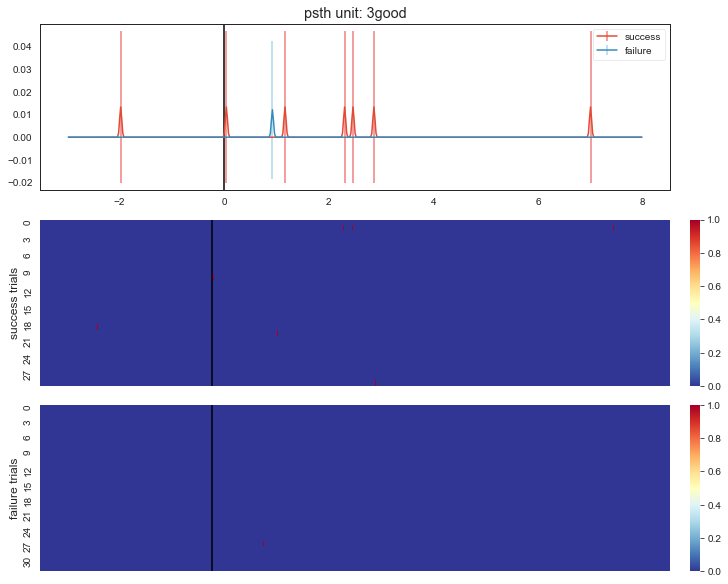

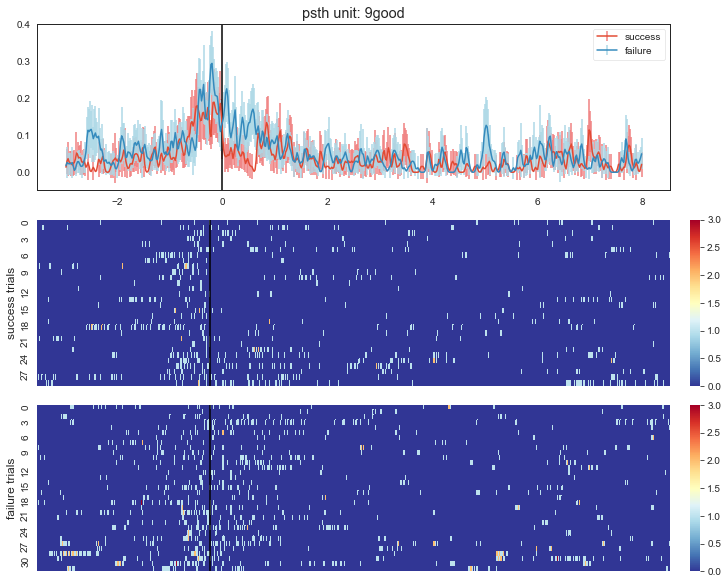

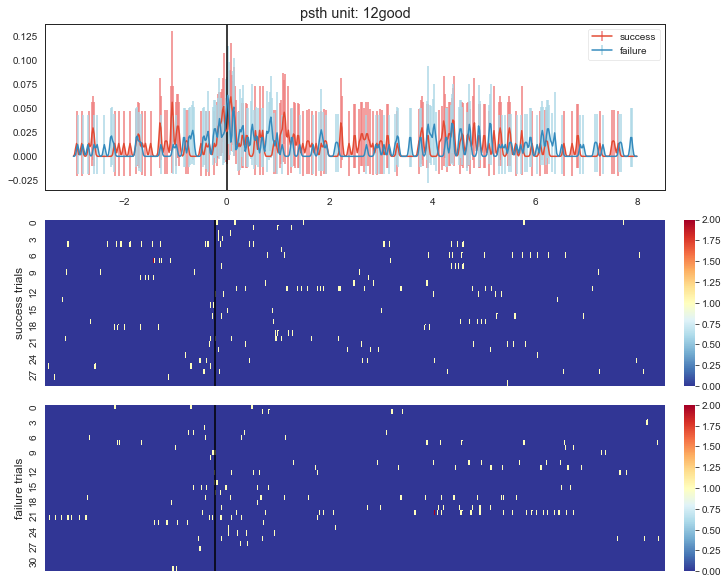

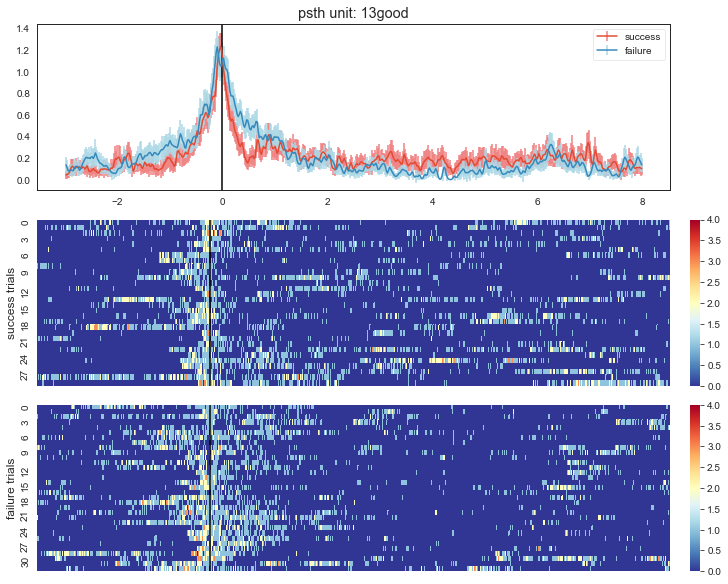

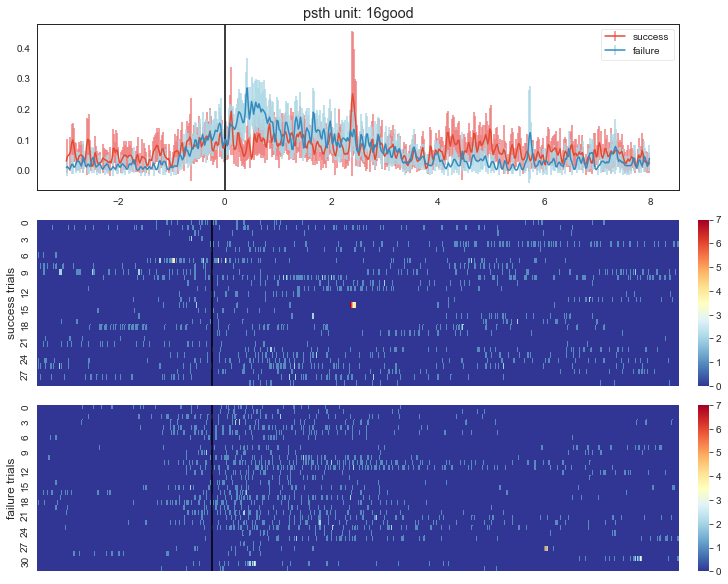

...

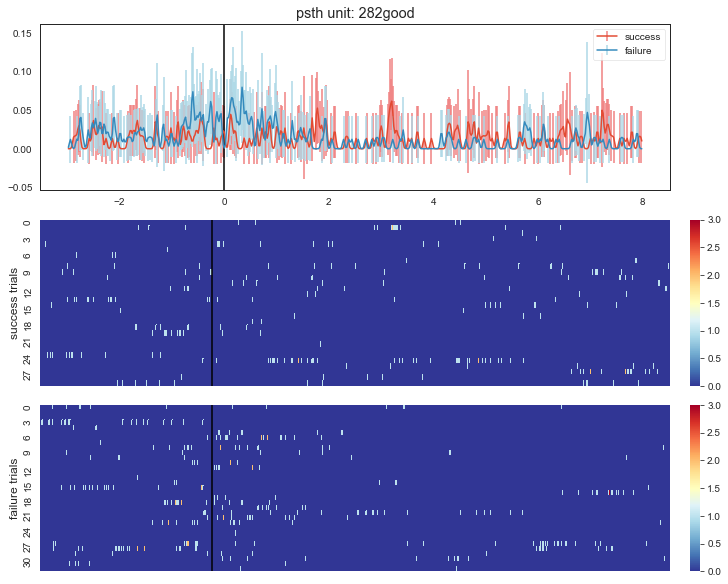

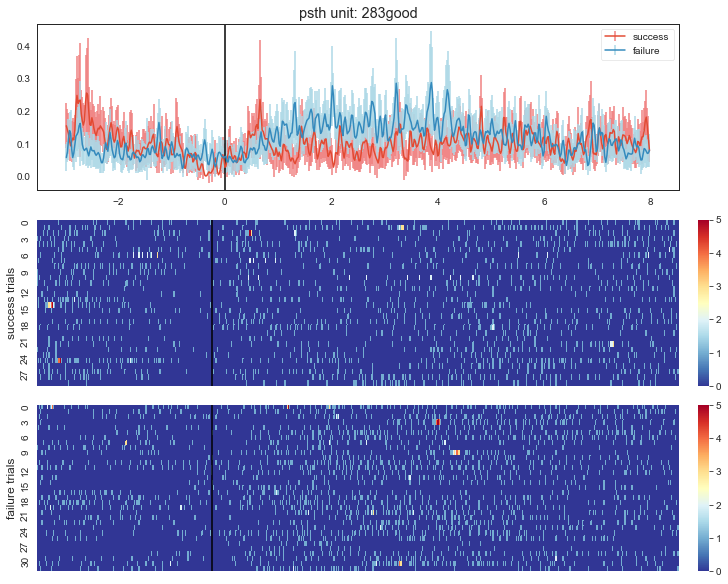

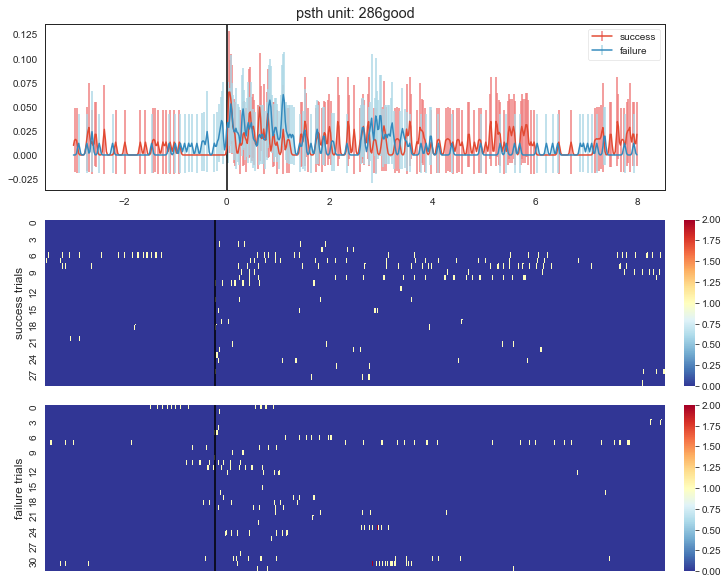

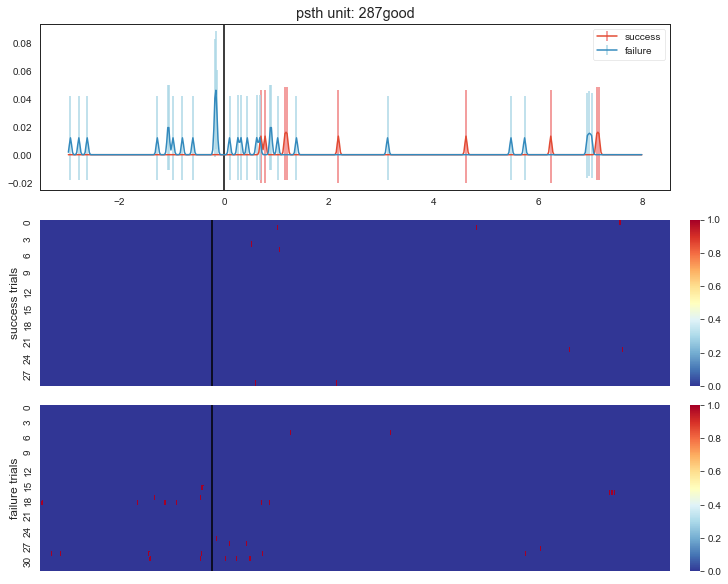

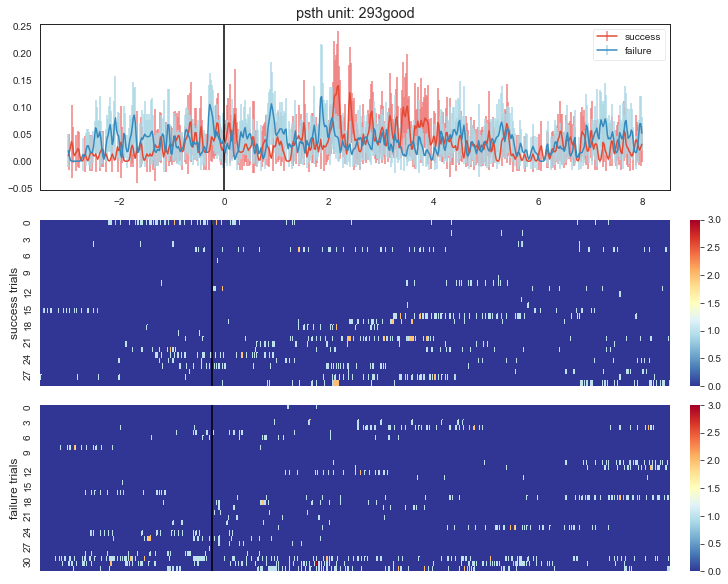

In [25]:
save_path = '/Users/kimberlygagnon/Documents/CU/WelleLab/figures/outcome/mouse_51/indicative/'
outcome.plot_outcome_units(df_mov,df_reaches,indicative_units,save_path,start=-3,end=8,binsize=0.020,save=False,norm=False)

In [28]:
df_mov = df[df.mod_up!='yes']
indicative_units = df_mov.index

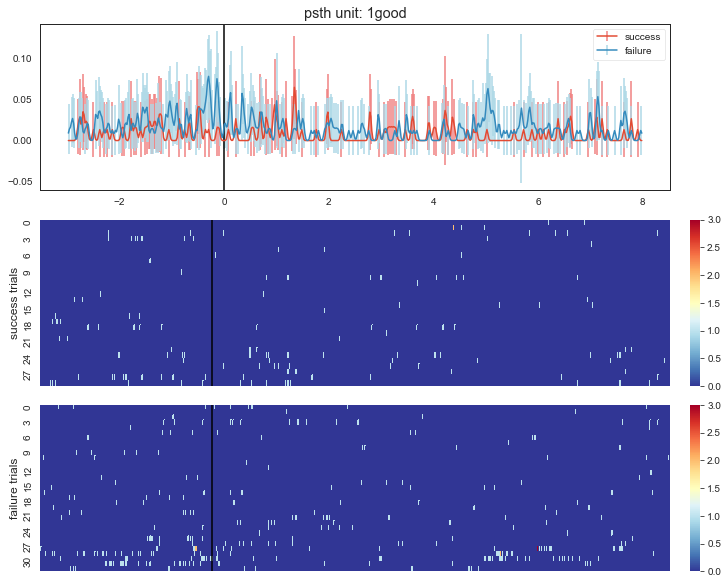

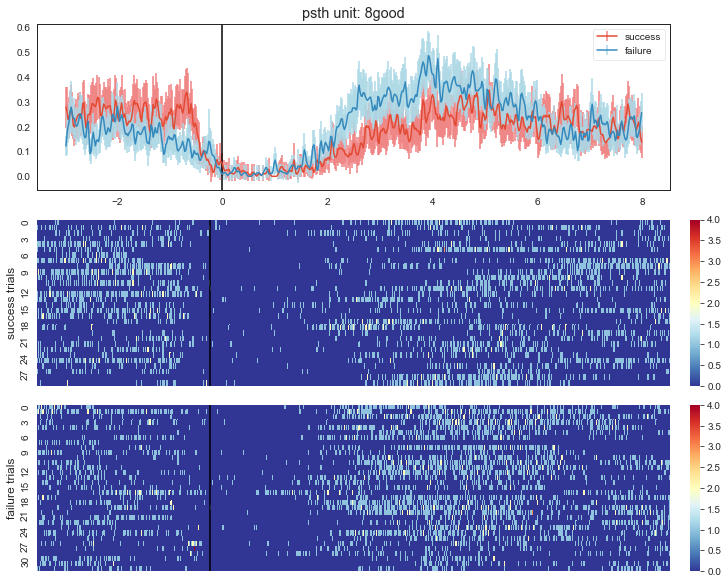

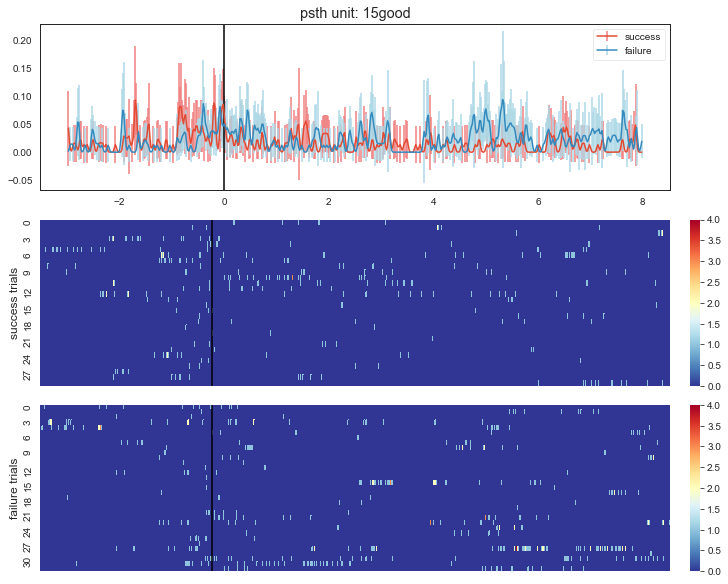

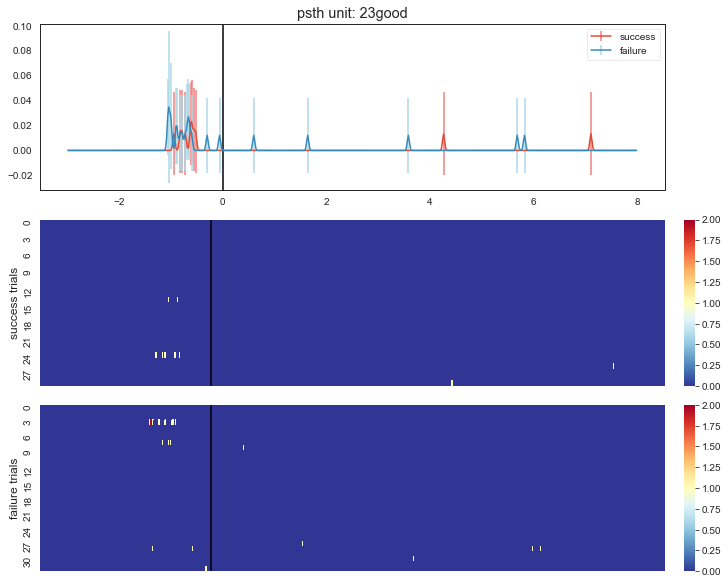

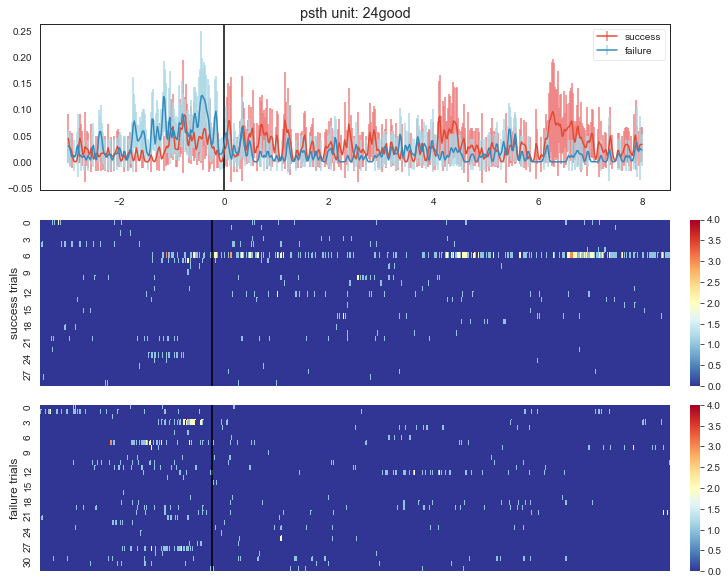

...

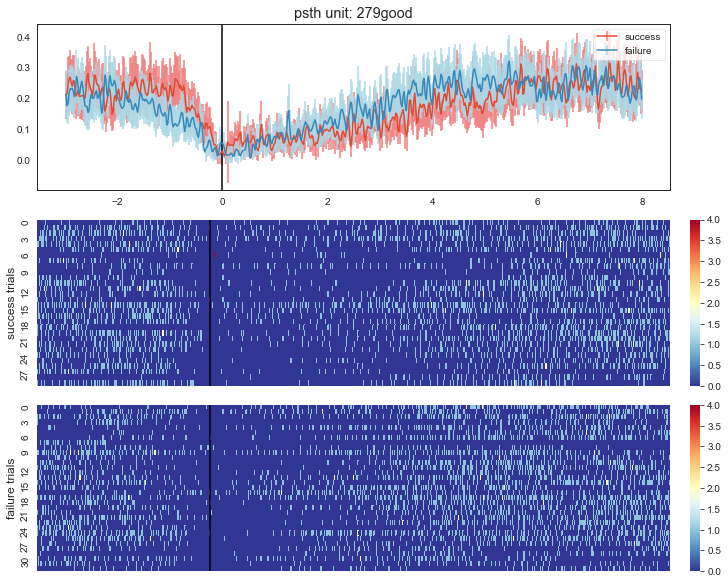

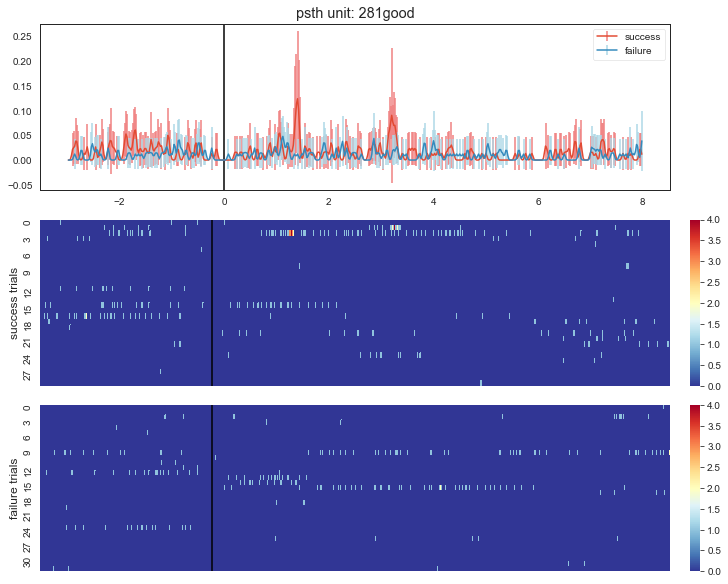

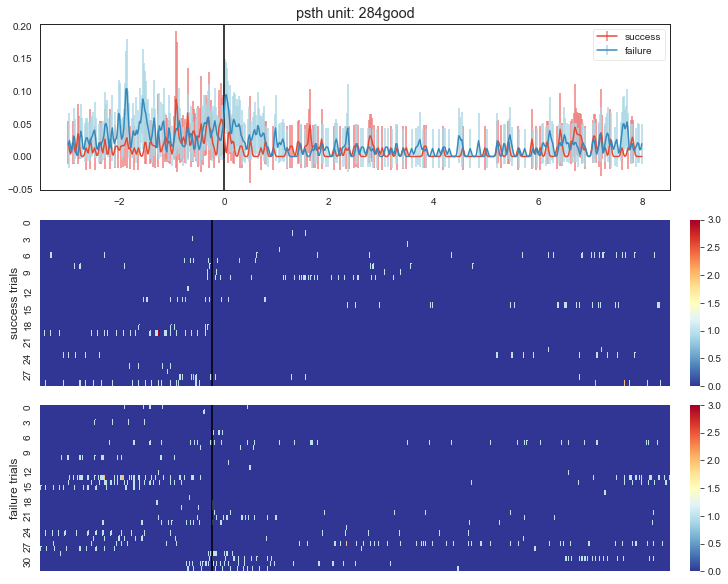

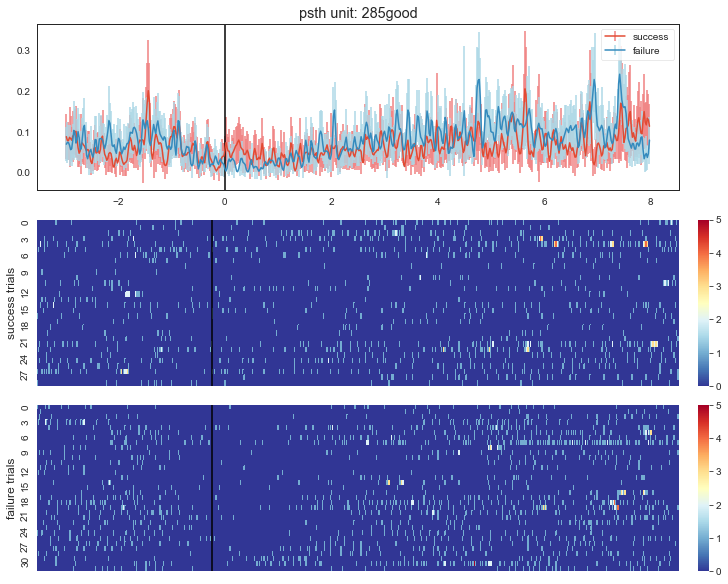

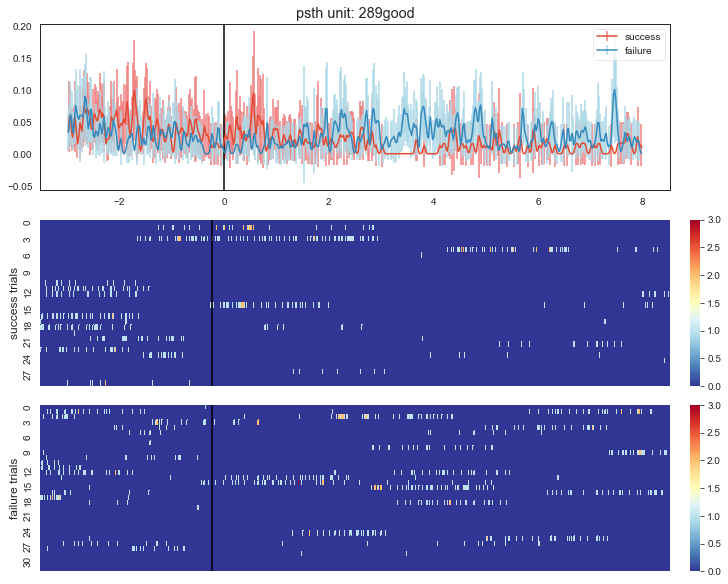

In [29]:
# not indicative
save_path = '/Users/kimberlygagnon/Documents/CU/WelleLab/figures/outcome/mouse_51/indicative/'
outcome.plot_outcome_units(df_mov,df_reaches,indicative_units,save_path,start=-3,end=8,binsize=0.020,save=False,norm=False)

In [26]:
df.index

Int64Index([  1,   3,   8,   9,  12,  13,  15,  16,  17,  18,
            ...
            280, 281, 282, 283, 284, 285, 286, 287, 289, 293],
           dtype='int64', length=121)

# plot indicative neurons from SVM

In [61]:
df,indicative_units,not_ind_units,prior = outcome.get_indicative_neurons(df,df_reaches,scores)

In [69]:
sns.scatterplot(x=df_noind,y=df.depth)

ValueError: Shape of passed values is (22, 2), indices imply (321, 2)

In [63]:
df_ind = df[df.indicative=='yes'][df.group=='good']


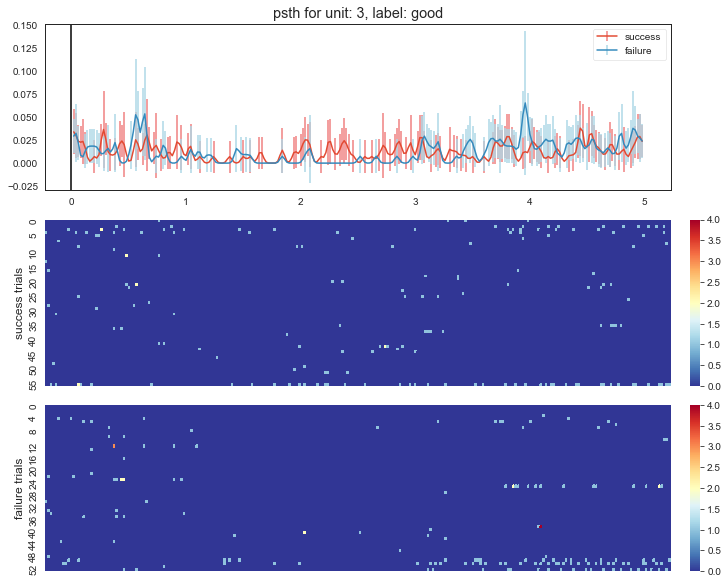

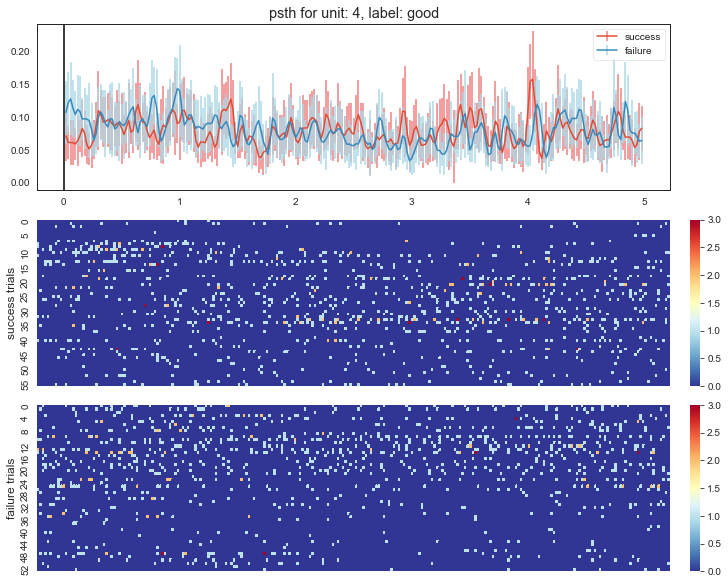

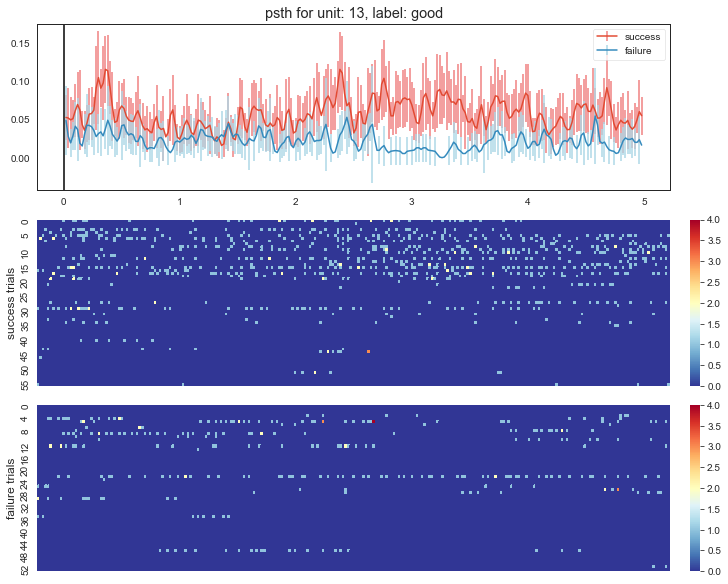

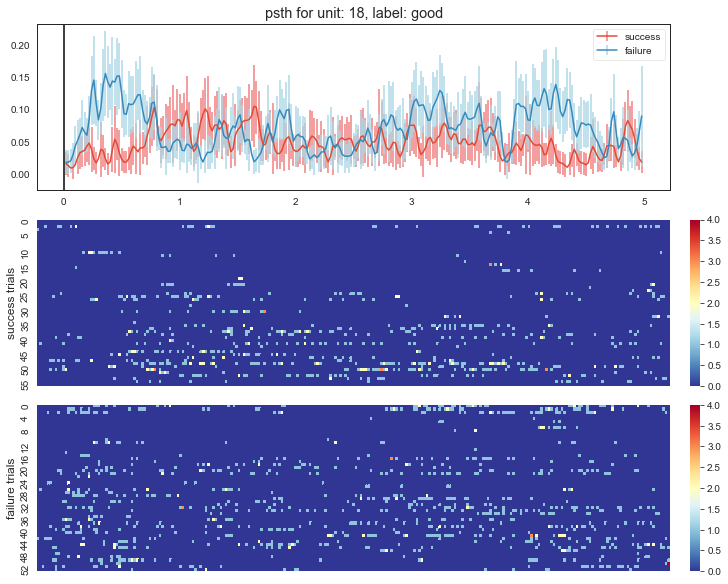

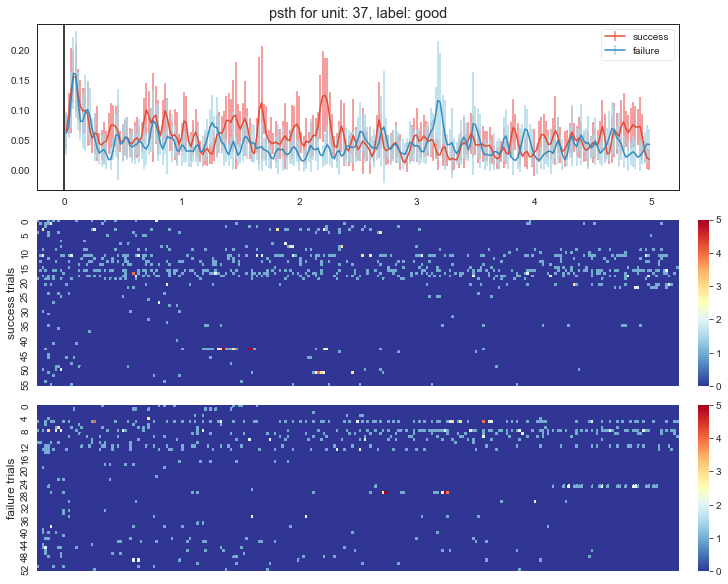

...

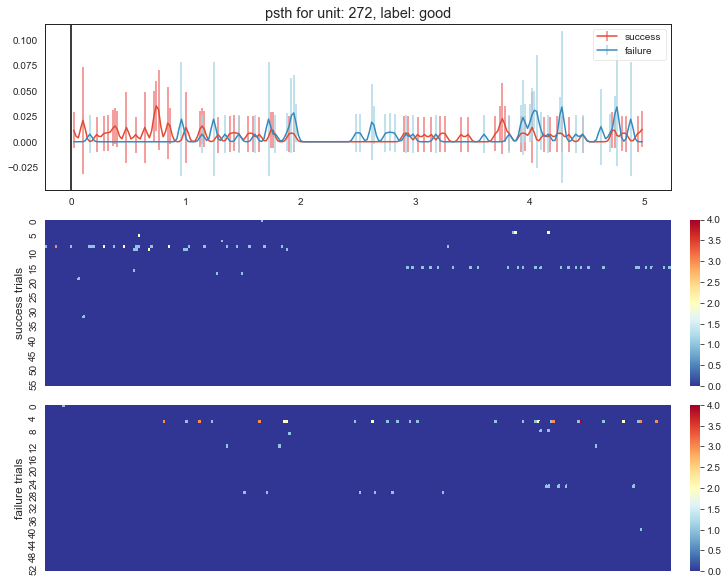

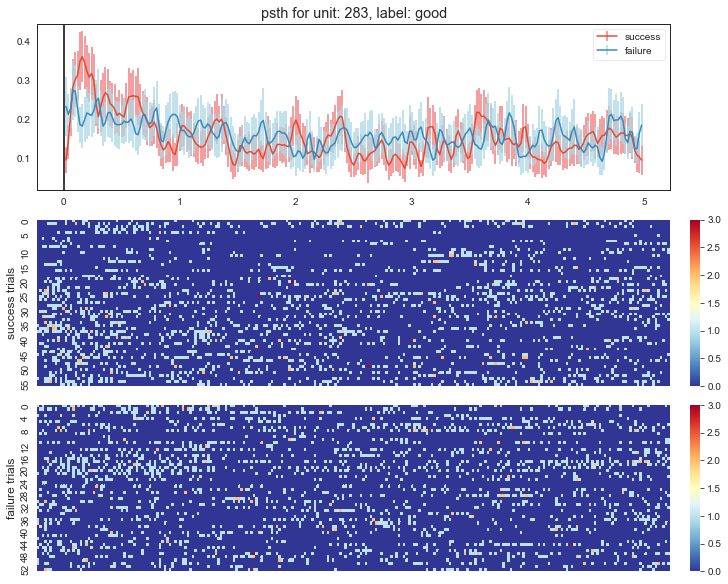

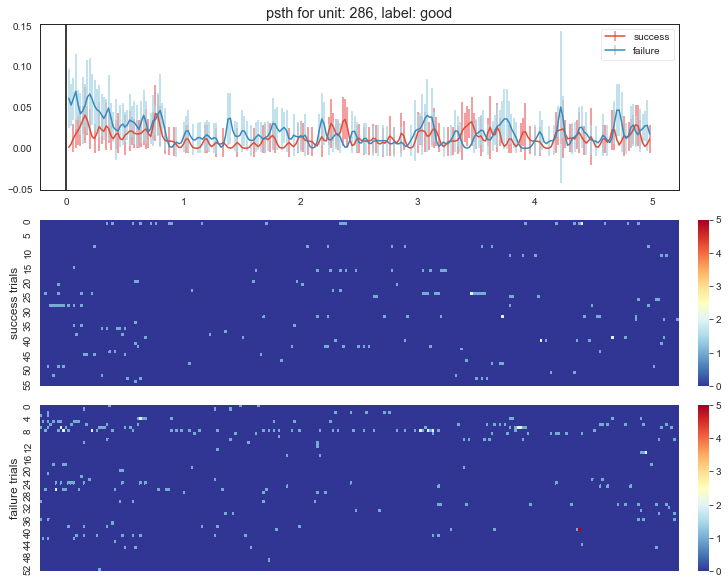

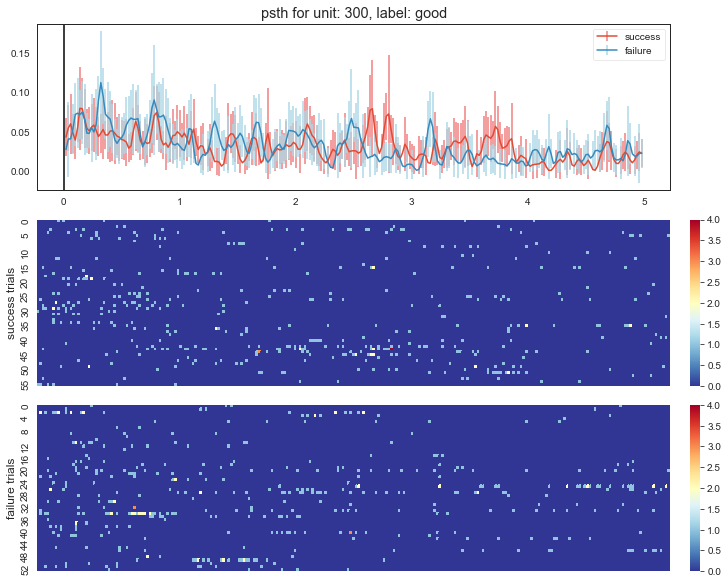

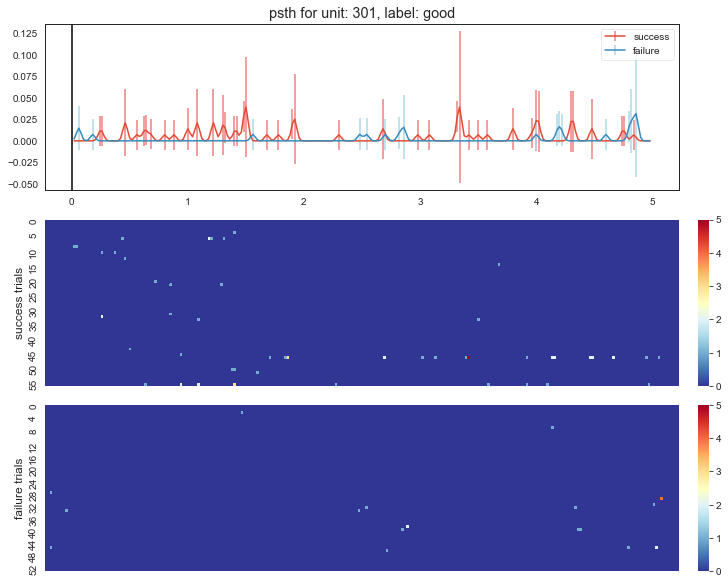

In [53]:
# add layer to title
save_path = '/Users/kimberlygagnon/Documents/CU/WelleLab/figures/outcome/mouse_51/indicative/'
outcome.plot_outcome_units(df_ind,df_reaches,indicative_units,save_path,start=0,end=5,binsize=0.020,save=False,norm=False)

In [ ]:
df.

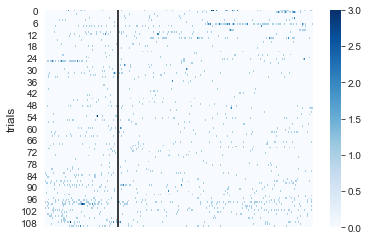

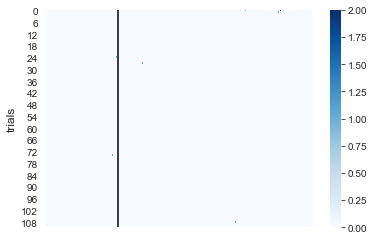

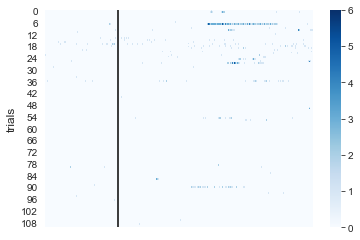

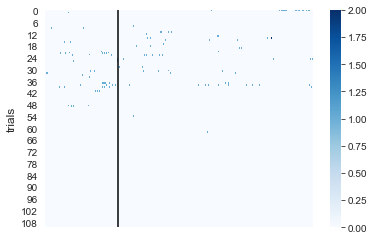

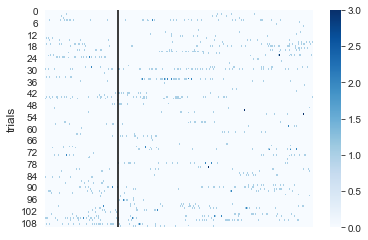

...

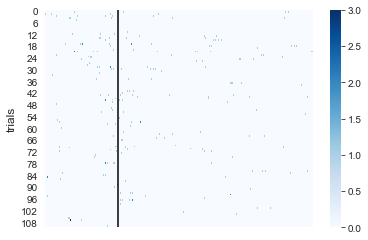

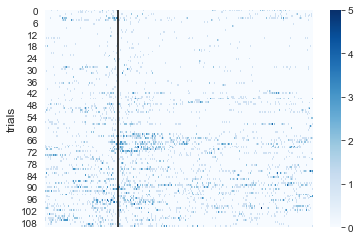

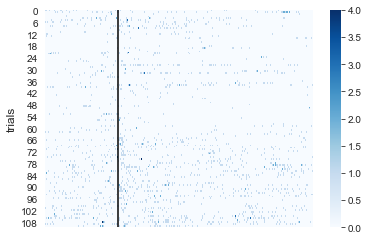

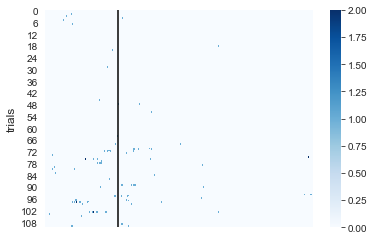

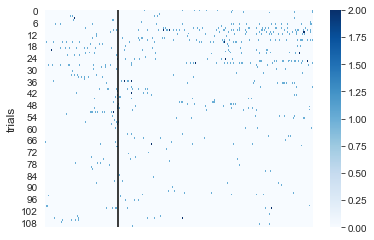

In [65]:
outcome.plot_rastor(df_ind,df_reaches,indicative_units,save_path,start=-3,end=8,binsize=0.020,save=False,norm=False)

In [66]:
df_noind = df[df.indicative=='no'][df.group=='good']

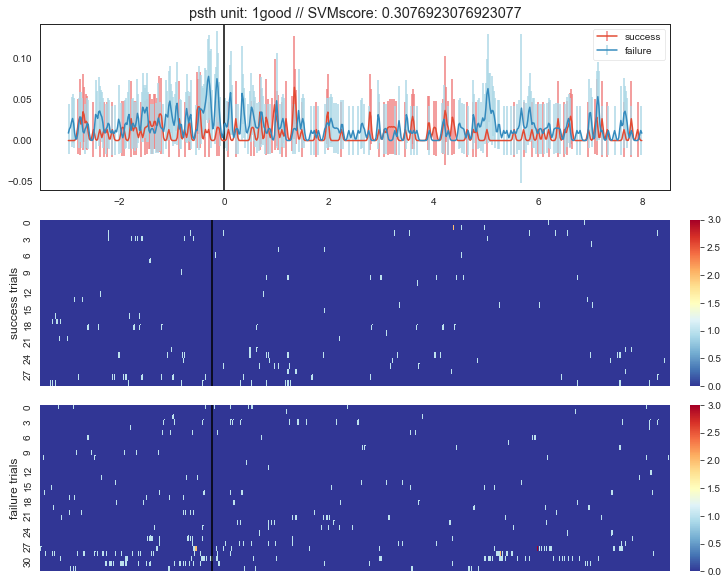

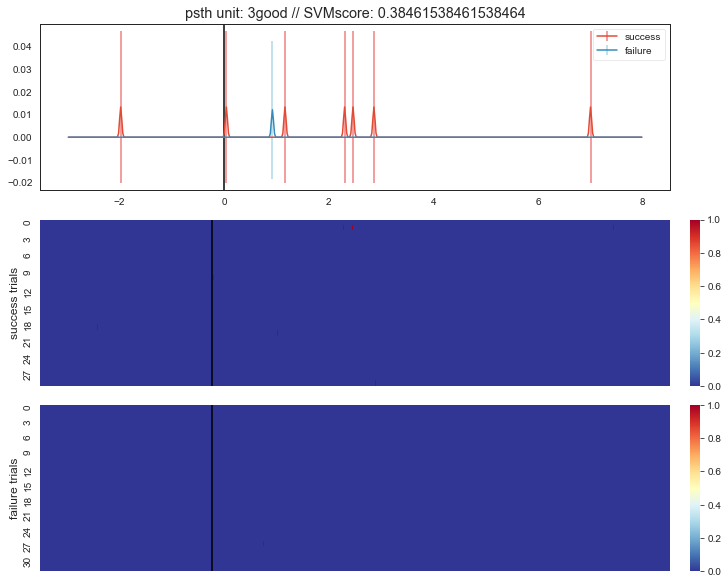

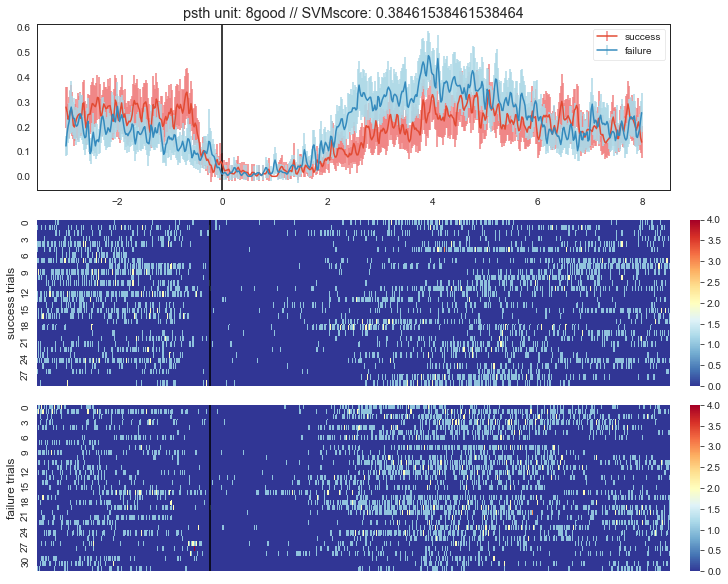

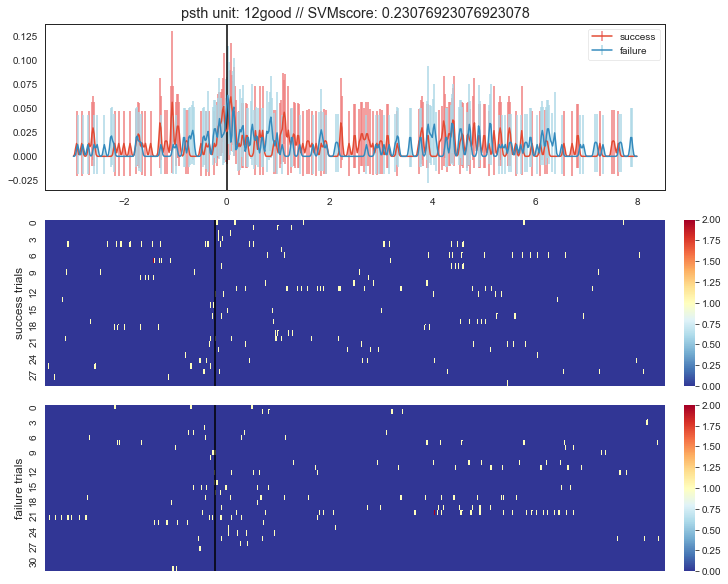

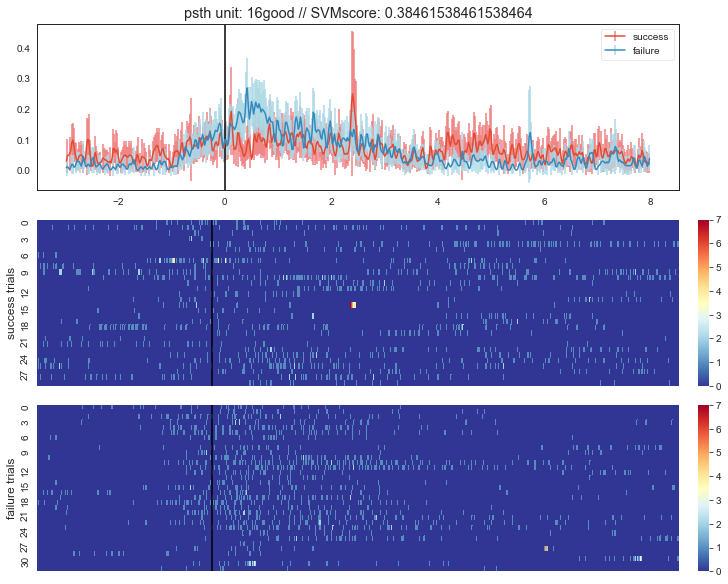

...

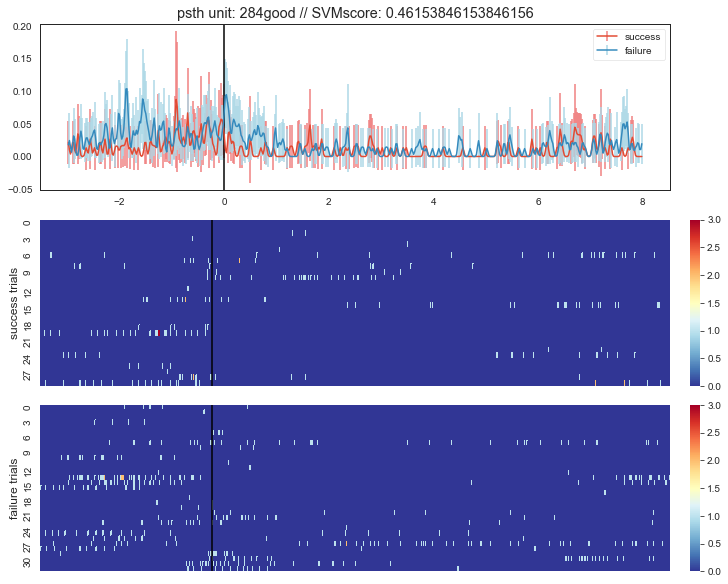

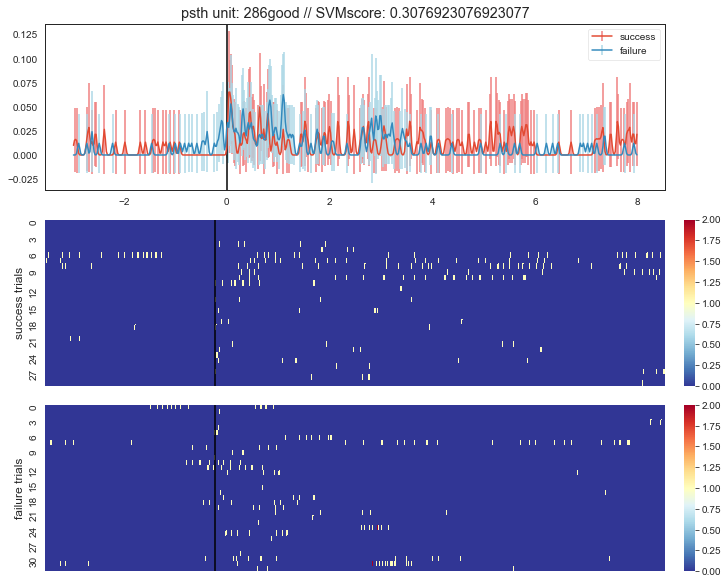

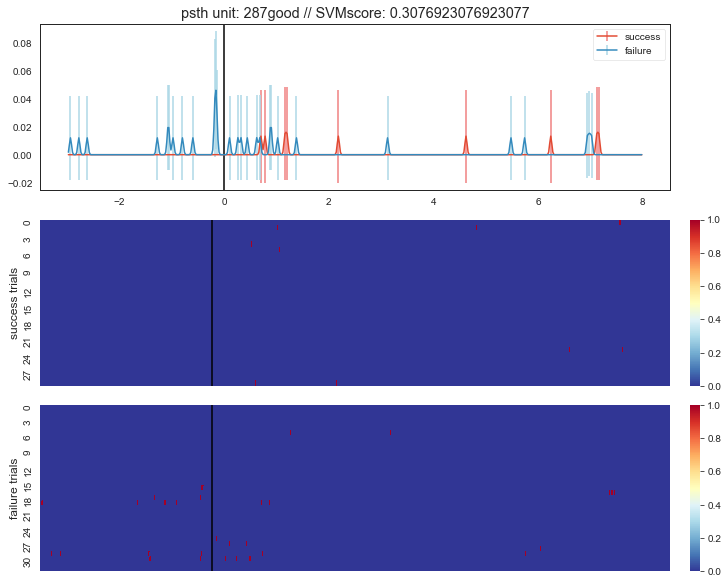

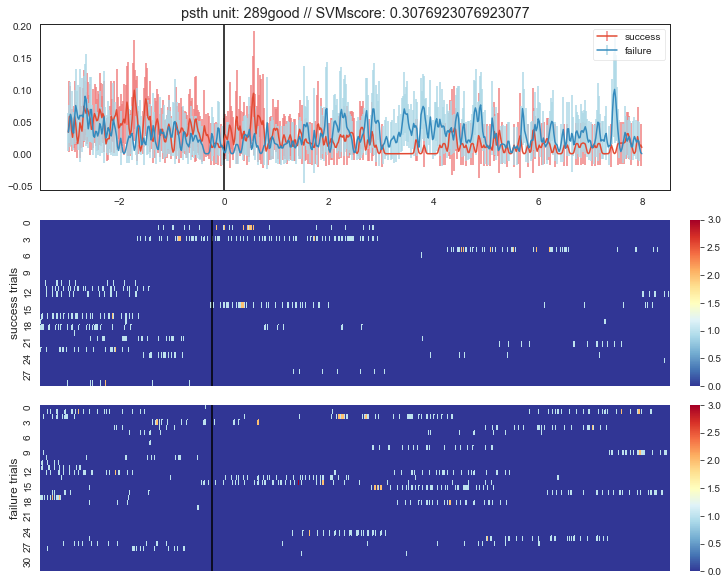

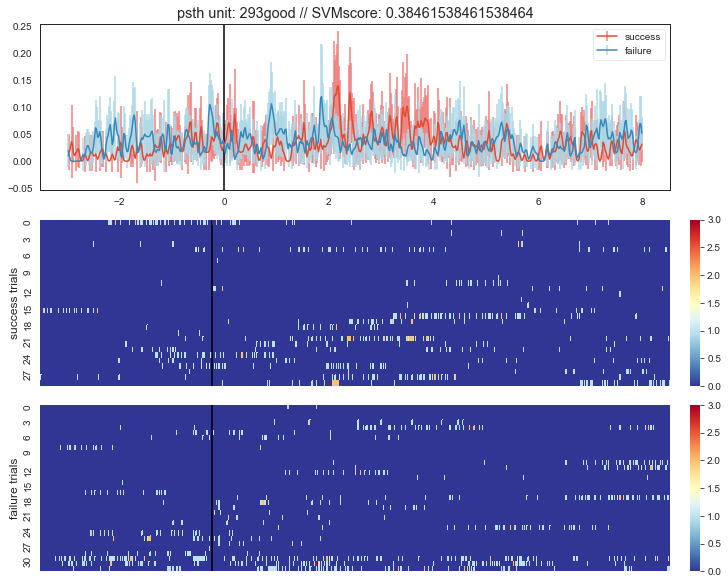

In [200]:
save_path = '/Users/kimberlygagnon/Documents/CU/WelleLab/figures/outcome/mouse_51/not_indicative/'
outcome.plot_outcome_units(df_noind,df_reaches,not_ind_units,save_path,start=-3,end=8,binsize=0.020,save=False,norm=False)

In [163]:
df_L23 = df[df.layer=='L2-3'][df.group=='good']
df_5 = df[df.layer=='L5'][df.group=='good']

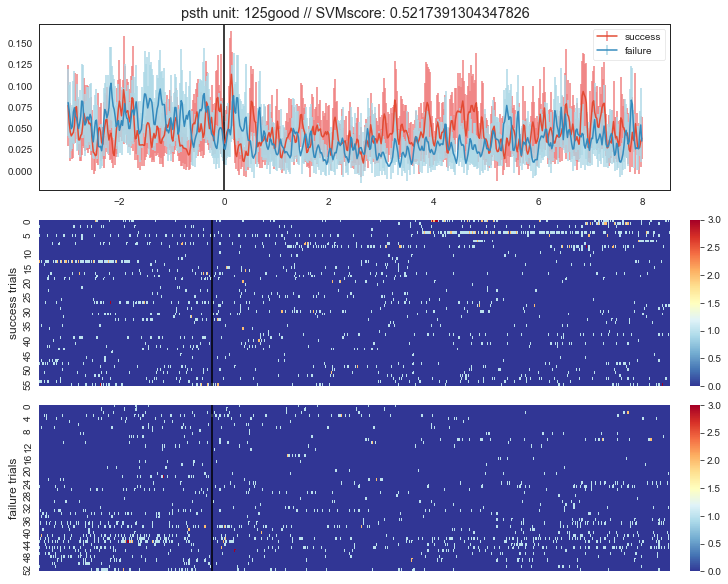

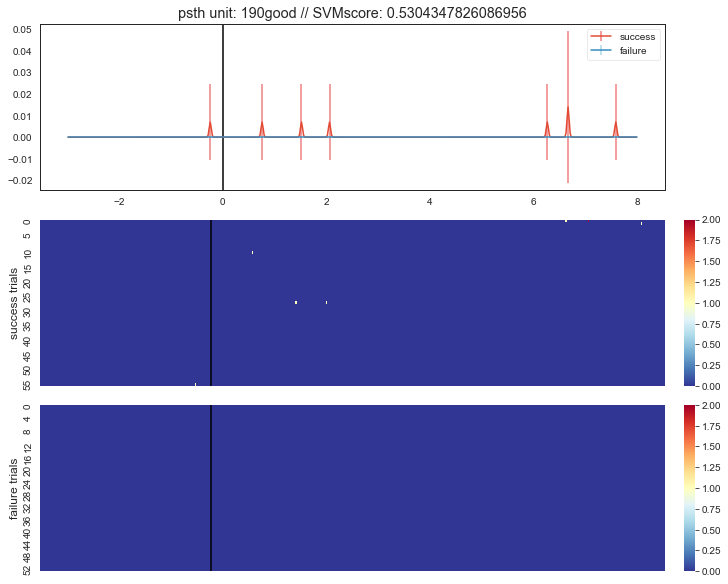

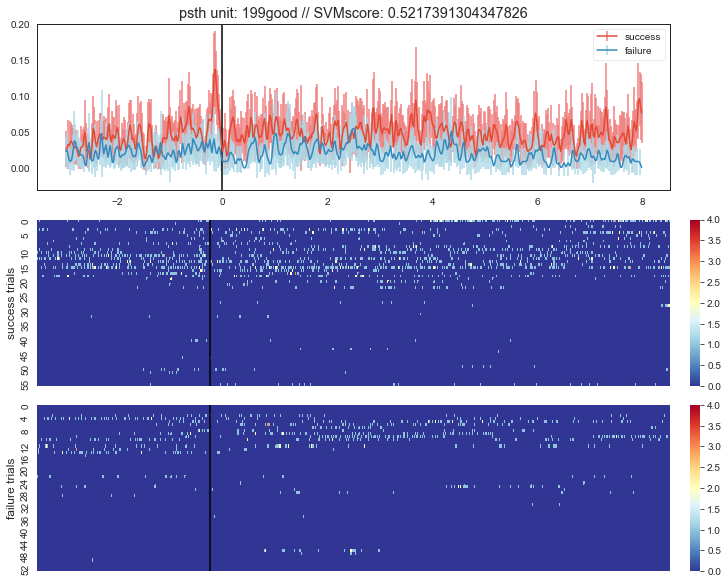

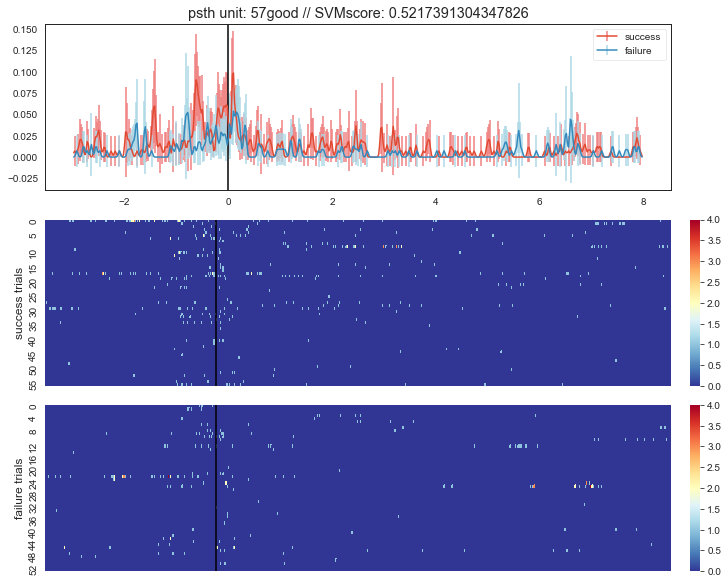

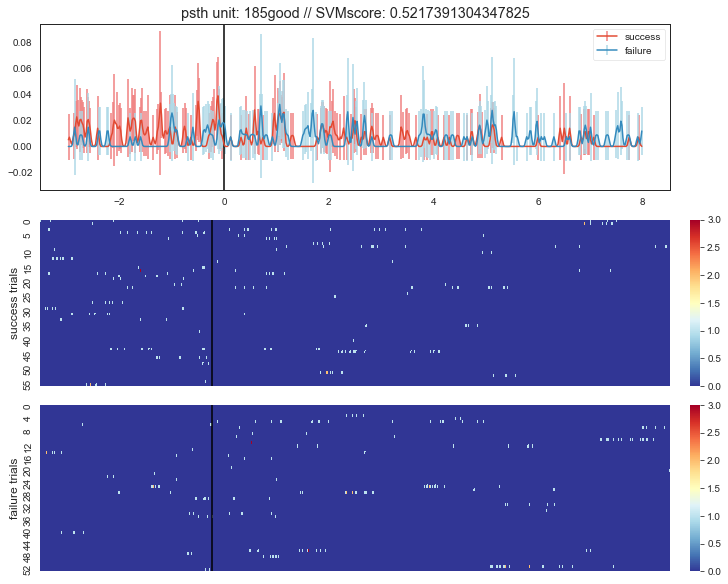

...

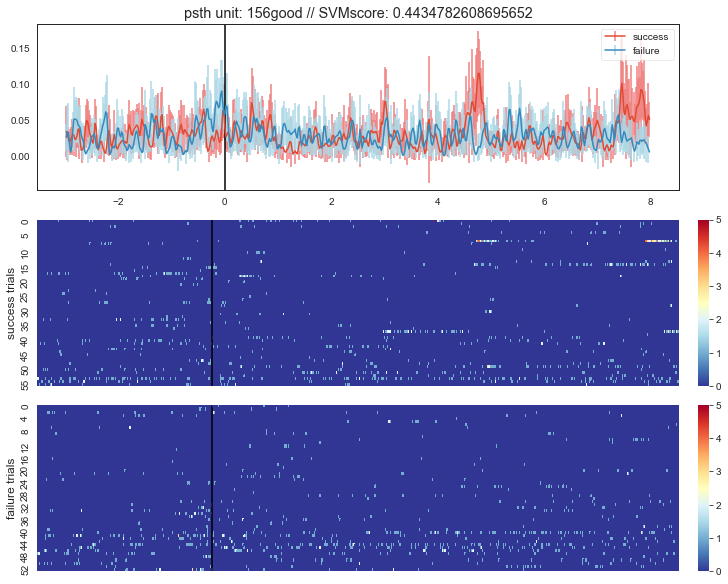

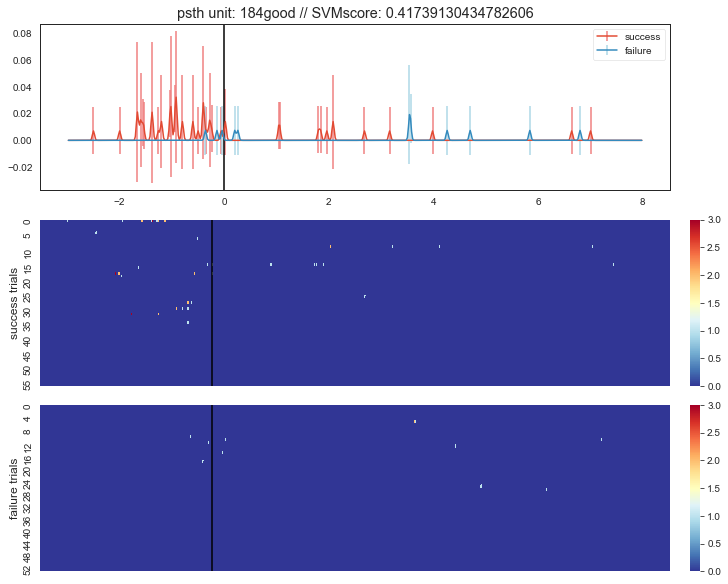

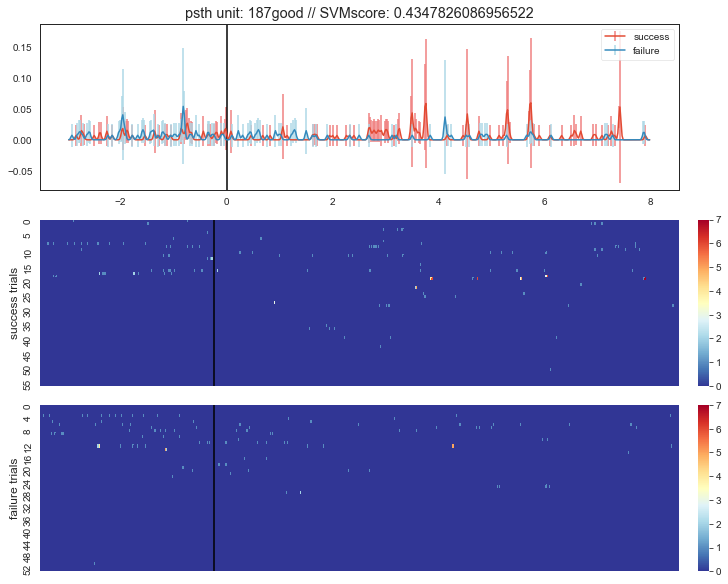

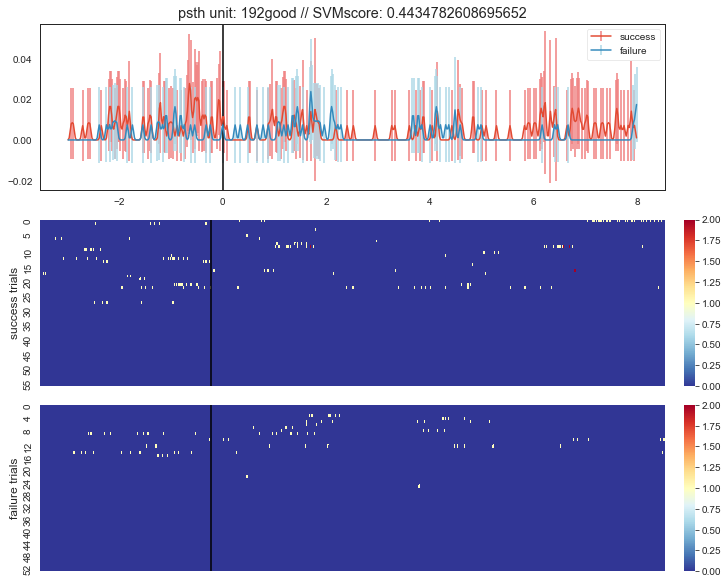

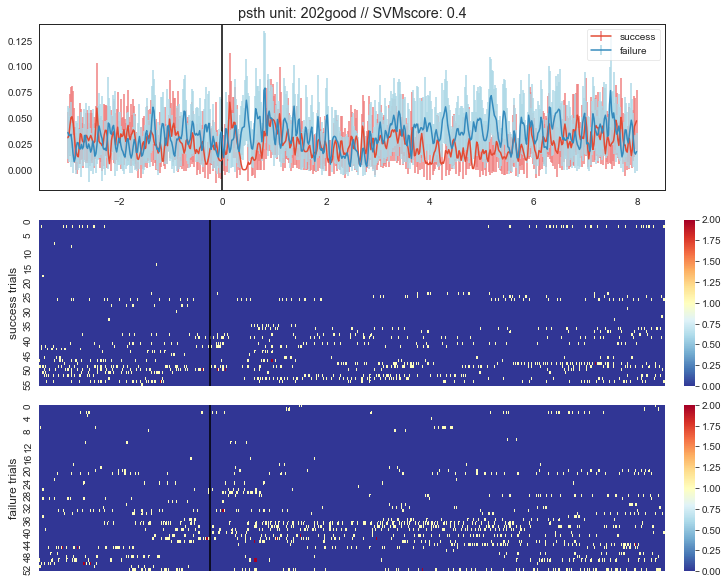

In [153]:
outcome.plot_outcome_units(df_L23,df_reaches,not_ind_units,save_path,start=-3,end=8,binsize=0.020,save=False,norm=False)

In [165]:
#rastor,rastor_norm,psths,units,psths_std = outcome.get_trials_byunit(df_L23,df_reaches,start=-3,end=8,binsize=0.020)
rastor,rastor_norm,psths_,units,psths_std = outcome.get_trials_byunit(df_5,df_reaches,start=-3,end=8,binsize=0.020)

# reliability

In [11]:
df = df[df.group=='good']

In [12]:
start = -2
end = 2
binsize = .001

In [13]:
rastor,rastor_norm,psths,units,psths_std = outcome.get_trials_byunit(df,df_reaches,start,end,binsize)

In [16]:
reliab = []
for i in rastor:
    reli = outcome.reliability(i)
    reliab.append(reli)

In [17]:
np.shape(reliab)

(159,)

In [18]:
df['reliability'] = reliab

In [ ]:
indicative_units = df.index
save_path = '/Users/kimberlygagnon/Documents/code/python/pipeline_final/figures/rastors_reliability'

outcome.plot_rastor(df,df_reaches,indicative_units,save_path,start,end,binsize,save=True,norm=False)



# other stuff

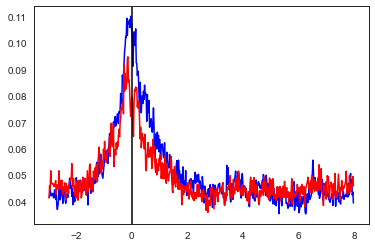

In [167]:
#L2/3
edges = np.arange(-3,8,.020)
psth = np.mean(psths,axis=0)
psth_ = np.mean(psths_,axis=0)
plt.plot(edges[1:],psth,'b')
plt.plot(edges[1:],psth_,'r')

plt.gca().axvline(0,c='black',ls='-')


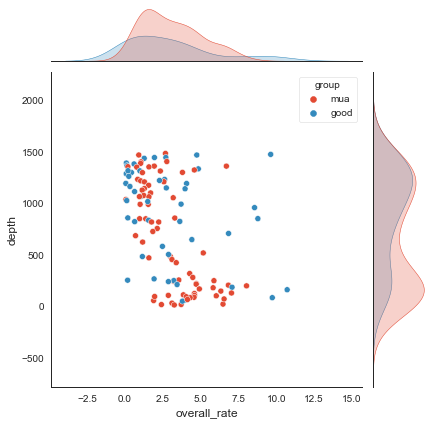

In [92]:
sns.jointplot(x=df_ind.overall_rate,y=df_ind.depth,hue=df_ind.group)

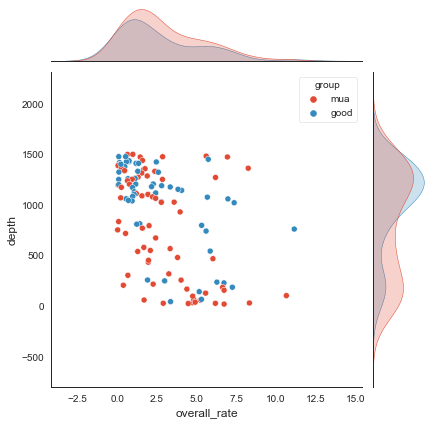

In [94]:
sns.jointplot(x=df_noind.overall_rate,y=df_noind.depth,hue=df_noind.group)

In [ ]:
sns.jointplot(x=df_noind.overall_rate,y=df_noind.depth,hue=df_noind.group)

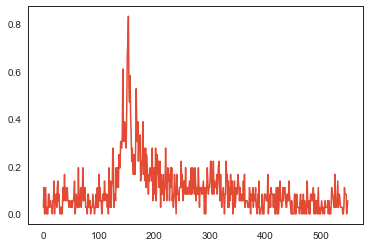

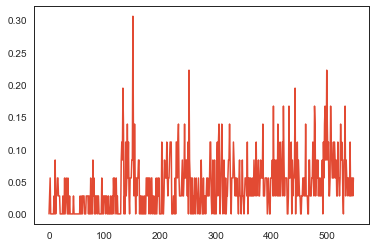

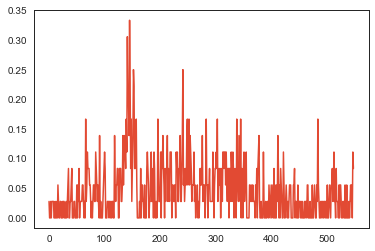

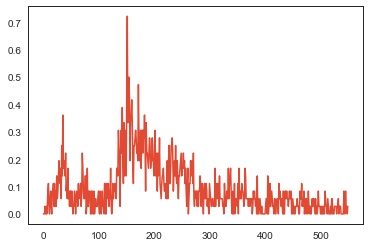

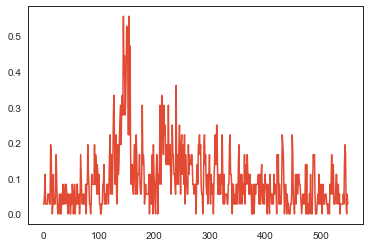

...

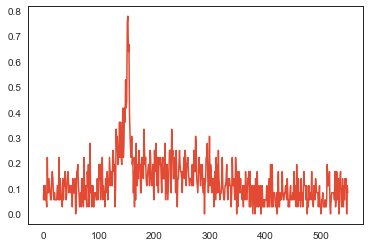

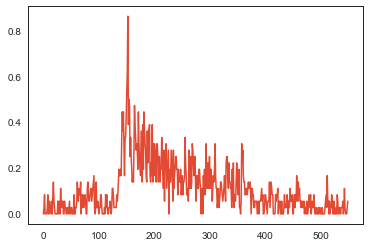

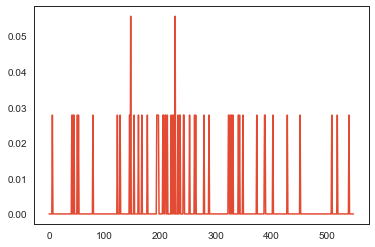

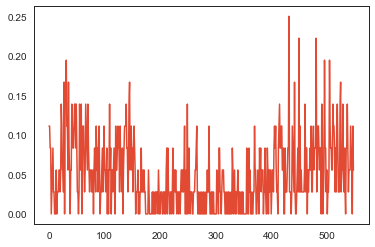

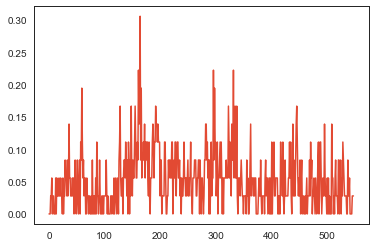

In [56]:
for i,bins in enumerate(rastor_s):
    plt.plot(psths_s[i])
    plt.show()
    plt.close()

In [ ]:
# NEXT:
ONLY ON GOOD UNITS
ROLLING SUM ?
DO FOR TIME BINS
plot PSTH, INCLUDE VARIANCE

# random code, ignore below --- cross validation code below

In [ ]:
# youtube example

In [88]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
X_train_scaled = scale(X_train)
X_test_scaled = scale(X_test)

In [89]:
clf_svm = SVC(random_state=42)
clf_svm.fit(X_train_scaled,y_train)


SVC(random_state=42)

In [278]:
plot_confusion_matrix(clf_svm,x_test_scaled,y_test,values_format='d')

NameError: name 'plot_confusion_matrix' is not defined

In [92]:
param_grid = [
    {'C': [0.5,1,10,100],
    'gamma': ['scale', 1,0.1,0.01,0.001,0.0001],
    'kernel': ['linear']},
]

optimal_params = GridSearchCV(SVC(),param_grid,cv=5,scoring='accuracy')
optimal_params.fit(X_train_scaled,y_train)
print(optimal_params.best_params_)

{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}


In [ ]:
clf_svm = SVC(random_state=42,C=,gamma=)
clf_svm.fit(X_train_scaled,y_train)

In [125]:
from sklearn import svm
from sklearn.model_selection import cross_val_score
clf = svm.SVC(kernel='linear', C=0.5, random_state=42)
scores = cross_val_score(clf, X, y, cv=10) 

NameError: name 'X' is not defined

In [ ]:
from sklearn.model_selection import ShuffleSplit
cv=10
n_samples = X.shape[0]
cv = ShuffleSplit(n_splits=5, test_size=0.2)
cross_val_score(clf, X, y, cv=cv)




In [ ]:
clf = make_pipeline(preprocessing.StandardScaler(), svm.SVC(C=1))
cross_val_score(clf, X, y, cv=cv)


# psth

In [131]:
df.mouse.unique()


array([18,  9, 11, 12, 19, 20, 21, 22, 24, 25, 26, 34, 42, 43, 47, 49, 50,
       51, 53, 56, 66])

In [132]:
df_reaches.mouse.unique()

array([11, 12, 18, 19, 20, 21, 22, 24, 42, 43, 47, 50, 51, 53, 56, 58, 66])

In [126]:
df = df_

In [128]:
df_reaches = dfr_

In [133]:
df = df[df.mouse==51].reset_index()

In [134]:
df_reaches = df_reaches[df_reaches.mouse==51].reset_index()

In [135]:
max(df.ypos)

3689.7069189293

In [136]:
min(df.ypos)

2145.7758295069

In [137]:
depth = []
for i,d in enumerate(df.ypos):
    if d>2650:
        depth.append('L5')
    else:
        depth.append('L2/3')
df['depth'] = depth

In [138]:
start = -3
end = 8
binsize = 0.020


In [ ]:
for i in df.depth.unique():
    df_temp = df[df.depth==i]
    sums_all,allunits = psth(df_temp,df_reaches,start,end,binsize)
    t = np.arange(-3,8,0.020)
    t = t[:549]
    plt.plot(sums_all)
    plt.gca().axvline(150,c='b',ls='-')
    plt.title('psth: total unit count ' + str(i) + ' timeframe: ' + str(start) + ', ' + str(end))
    plt.show()
    plt.close()

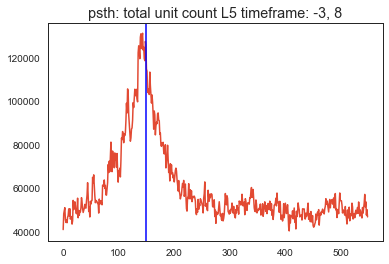

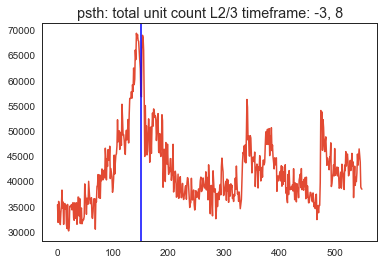

In [147]:
for i in df.depth.unique():
    df_temp = df[df.depth==i]
    sums_all,allunits = psth(df_temp,df_reaches,start,end,binsize)
    plt.plot(sums_all)
    plt.gca().axvline(150,c='b',ls='-')
    plt.title('psth: total unit count ' + str(i) + ' timeframe: ' + str(start) + ', ' + str(end))
    plt.show()
    plt.close()

# ignore this

In [89]:
edges=np.arange(start,end,binsize)
num_bins=edges.shape[0]
alltrials = []
outcomes = []
units = []
reach = []

byreach=np.zeros((np.shape(df_reaches)[0],num_bins))
allunits = []
trajs = []
evs = []
outcomes = []
units = []
reach = []
units_=[]
reachs=[]
hists=[]
hist_rastor = []
sums_ = []
edg = []

for i,times in enumerate(df.times): #compare that unit's spike times to each reach max
    t = np.array(times) #for reach unit create an array of that unit's spike times
    byreach=np.zeros((np.shape(df_reaches)[0],num_bins))
    for j,tmax in enumerate(df_reaches.rMax_t): #for each unit 
        #a = tmax+start
        #b = tmax+end
        #unit = df.index[i]
        #units.append(unit)
        #rea = df_reaches.behaviors[j]
        #reach.append(rea)
        edges = np.arange(tmax+start,tmax+end,binsize)
        spikes_reach = np.array(t[(t >= tmax+start) & (t <= tmax+end)]) #find if that unit spiked within designated timeframes around reachmax
        #spikes_reach = np.array(t[(t >= a) & (t <= b)]) #find if that unit spiked within designated timeframes around reachmax
        print(spikes_reach)
        if spikes_reach!=[]:
            #edges=np.arange(a,b,binsize)
            #edges = edges[:550]#designated bins around this iteration of reachmax
            #num_bins=edges.shape[0] #number of bins 
            #print(num_bins)
            hist=np.histogram(spikes_reach,bins=550)[0] #bin spikes into timeframe
            byreach[j,:]  = hist
            byreach_df = hists.append(hist) # list
            #byreach = center(byreach)
            sums = np.sum(byreach,axis=0)
            sums_.append(sums)
    sums_all = np.sum(sums_,axis=0)
    allunits.append(sums) # tensor rastor - every trial response for every neuron
    #reachs.append(reach) # which reach
    #units_.append(units) # unit id
    hist_rastor.append(hists) #list rastor 

# heatmaps

In [51]:
# work around if not use SVM

In [8]:
def movement_mod(df,df_reaches,startb,endb,starte,ende,binsize=0.001): #binsize 1 ms
    
    edgesb=np.arange(startb,endb,binsize)
    num_binsb=edgesb.shape[0]-1 #number of bins

    edgese=np.arange(starte,ende,binsize)
    num_binse=edgese.shape[0]-1 #number of bins

    byreach_b=np.zeros((len(df_reaches.rMax_t),num_binsb))
    byreach_e=np.zeros((len(df_reaches.rMax_t),num_binse))

    mod_up = []
    mod_down = []
    maxfr_ts = []
    minfr_ts = []
    maxfrs = []

    for i,times in enumerate(df.times): #for each unit 
        t = np.array(times) #for reach unit create an array of that unit's spike times
    
        for j,tmax in enumerate(df_reaches.rMax_t): 
        
            base = np.array(t[(t >= tmax+startb) & (t <= tmax+endb)])
            epoch = np.array(t[(t >= tmax+starte) & (t <= tmax+ende)])
        
            edgesb = np.arange(tmax+startb,tmax+endb,binsize)
            edgese = np.arange(tmax+starte,tmax+ende,binsize)
        
            histb=np.histogram(base,edgesb)[0] 
            histe=np.histogram(epoch,edgese)[0]
    
            byreach_b[j,:] = histb
            byreach_e[j,:] = histe
    
        meanbinfr_b = np.mean(byreach_b,axis=0)
        mfrb_ser = pd.Series(meanbinfr_b)        
        rolave_mfrb = mfrb_ser.rolling(100).sum() #takes sum of 100bins, shifts 1bin .. 100 bins binned at 1 ms = 100ms summed bins
        rolave_mfrb = np.array(rolave_mfrb.dropna())
        #lower,upper = sms.DescrStatsW(rolave_mfrb).tconfint_mean() #fix this
        upper = np.mean(rolave_mfrb) + (2.56*std(rolave_mfrb))
        lower = np.mean(rolave_mfrb) - (2.56*std(rolave_mfrb))

        meanbinfr_e = np.mean(byreach_e,axis=0)
        mfr_ser = pd.Series(meanbinfr_e)        
        rolave_mfr = mfr_ser.rolling(100).sum() #takes sum of 100bins, shifts 1bin
        maxfr = np.max(rolave_mfr)/.1
        maxfr_t = edgese[np.argmax(rolave_mfr)]-tmax
        minfr_t = edgese[np.argmin(rolave_mfr)]-tmax
        
        maxfrs.append(maxfr)
        maxfr_ts.append(maxfr_t)
        minfr_ts.append(minfr_t)

        mfr_a = np.array(rolave_mfr)
        up = np.where(mfr_a >= upper)[0].tolist()
        down = np.where(mfr_a <= lower)[0].tolist()

        consec_up = np.array(countlist(up))
        consec_down = np.array(countlist(down))

        if any(consec_up >= 1000): #if there are 50 consecutive bins
            ups = 'yes'
            mod_up.append(ups)
        else:
            ups_ = 'no'
            mod_up.append(ups_)
    
        if any(consec_down >= 1000): #if there are 50 consecutive bins
            downs = 'yes'
            mod_down.append(downs)
        else:
            downs_ = 'no'
            mod_down.append(downs_)

    return mod_up, mod_down, maxfr_ts, minfr_ts, maxfrs

In [9]:
def countlist(lst): #to count consecutive numbers in movement-related code
    streak_count = []
    counter = 1
    for i in range(len(lst)):
        if i != (len(lst) - 1):
            diff = lst[i+1] - lst[i]
            if diff == 1:
                counter += 1
            else:
                streak_count.append(counter)
                counter = 1
        else:
            streak_count.append(counter)
    return(streak_count)

In [10]:
mod_up, mod_down, maxfr_ts, minfr_ts, a = movement_mod(df,df_reaches,startb = -2.0,endb = -1.0,starte = 0,ende = 8,binsize=0.001)
df['mod_up_s'] = mod_up
df['mod_down_s'] = mod_down
df['peakup_s'] = maxfr_ts
df['peakdown_s'] = minfr_ts

In [11]:
df = df[df.mod_up_s=='yes']


In [12]:
df_reaches = df_reaches[df_reaches.behaviors!='success']
df_reaches = df_reaches.reset_index()
df_reaches = df_reaches.drop('index',axis=1)


In [13]:
df_ = df


In [14]:
start = -3
end = 8
binsize = 0.020

edges=np.arange(start,end,binsize)
num_bins=edges.shape[0] #number of bins 
byreach=np.zeros((np.shape(df_reaches)[0],num_bins))
alltrials = []
trajs = []
evs = []
outcomes = []
units = []
reach = []
units_=[]
reachs=[]
hists=[]
hist_df = []

for i,times in enumerate(df.times): #compare that unit's spike times to each reach max
    t = np.array(times) #for reach unit create an array of that unit's spike times
    byreach=np.zeros((np.shape(df_reaches)[0],num_bins))
    for j,tmax in enumerate(df_reaches.rMax_t): #for each unit 
        a = tmax+start
        b = tmax+end
        unit = df.index[i]
        units.append(unit)
        rea = df_reaches.behaviors[j]
        reach.append(rea)
        try:
            rd = np.array(t[(t >= a) & (t <= b)]) #find if that unit spiked within designated timeframes around reachmax
            edges=np.arange(a,b,binsize) #designated bins around this iteration of reachmax
            num_bins=edges.shape[0]-1 #number of bins 
            hist=np.histogram(rd,edges)[0] #bin spikes into timeframe
            byreach[j,:] = hist
            byreach_df = hists.append(hist) # list
            byreach = center(byreach)
        except:
            []

    alltrials.append(byreach) # tensor rastor - every trial response for every neuron
    #psth = sum(alltrials,axis=1) # 
    #reachs.append(reach) # which reach
    #units_.append(units) # unit id
    #hist_df.append(hists) #list rastor 

In [61]:
def center(X):
    # X: ndarray, shape (n_features, n_samples)
    ss = StandardScaler(with_mean=False, with_std=True)
    Xc = ss.fit_transform(X.T).T
    return Xc

In [30]:
save_path = r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\outcome\47'

In [ ]:
for i in df.depth.unique():
    df_temp = df[df.depth==i]
    sums_all,allunits = psth(df_temp,df_reaches,start,end,binsize)
    plt.plot(sums_all)
    plt.gca().axvline(150,c='b',ls='-')
    plt.title('psth: total unit count ' + str(i) + ' timeframe: ' + str(start) + ', ' + str(end))
    plt.show()
    plt.close()

In [16]:
for i,trial in enumerate(alltrials):
    sums = np.sum(trial,axis=0)
    plt.plot(sums)
    #fig.savefig(save_path + '/' + str('success')+str(i)+'.png')
    plt.close()

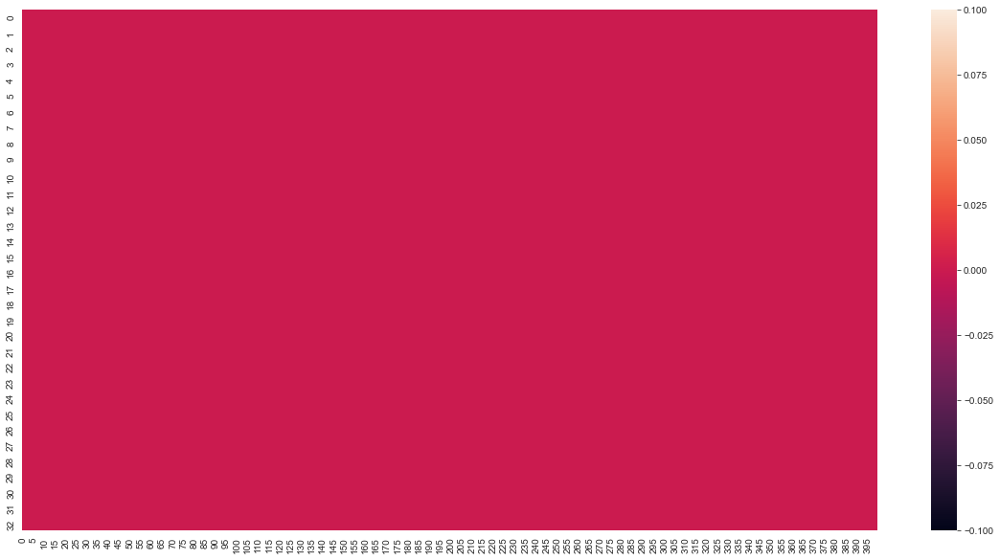

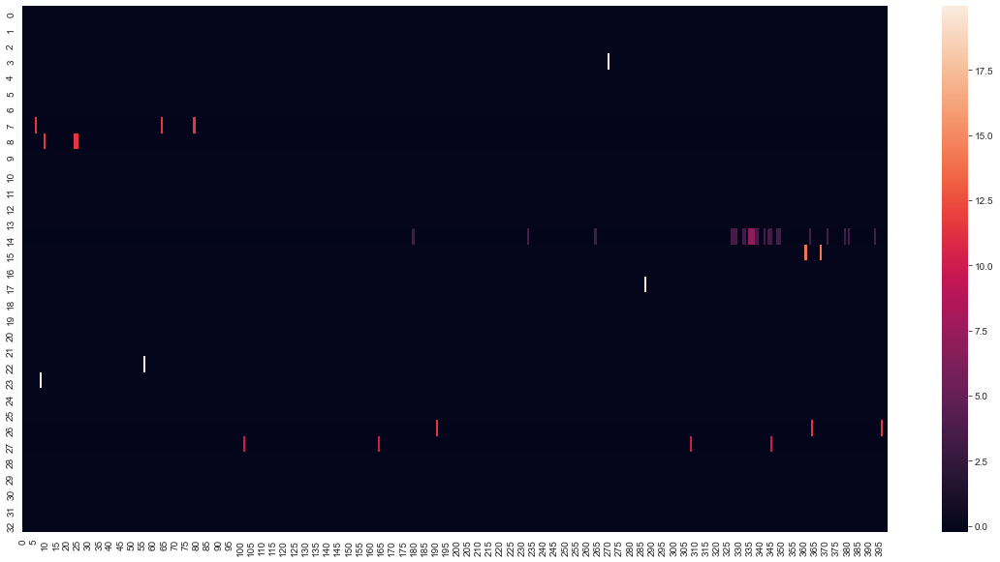

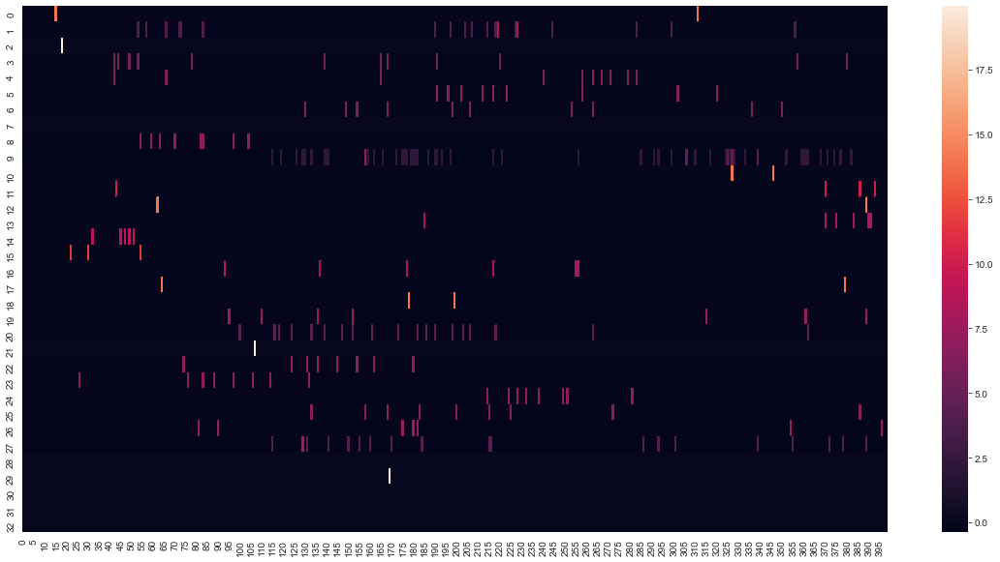

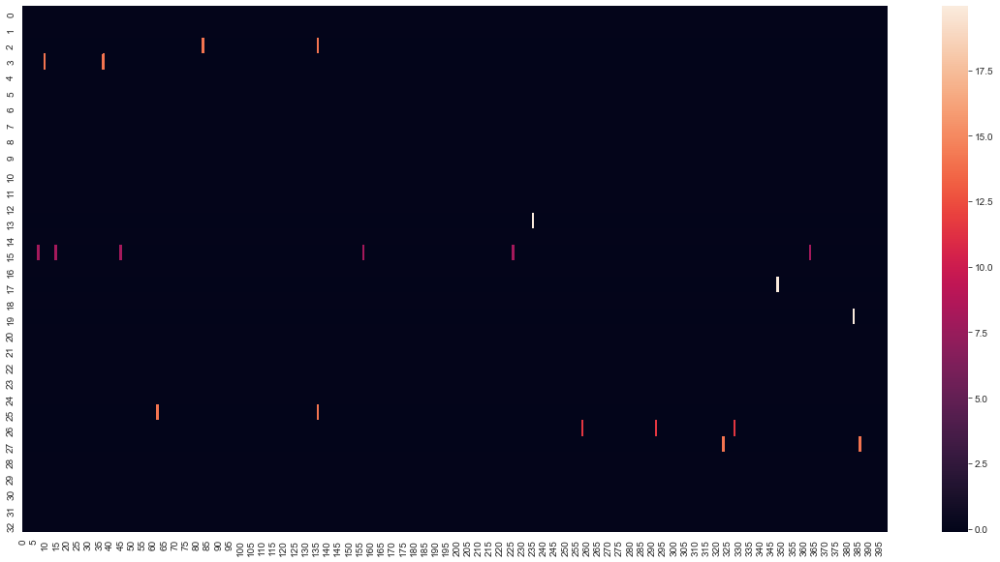

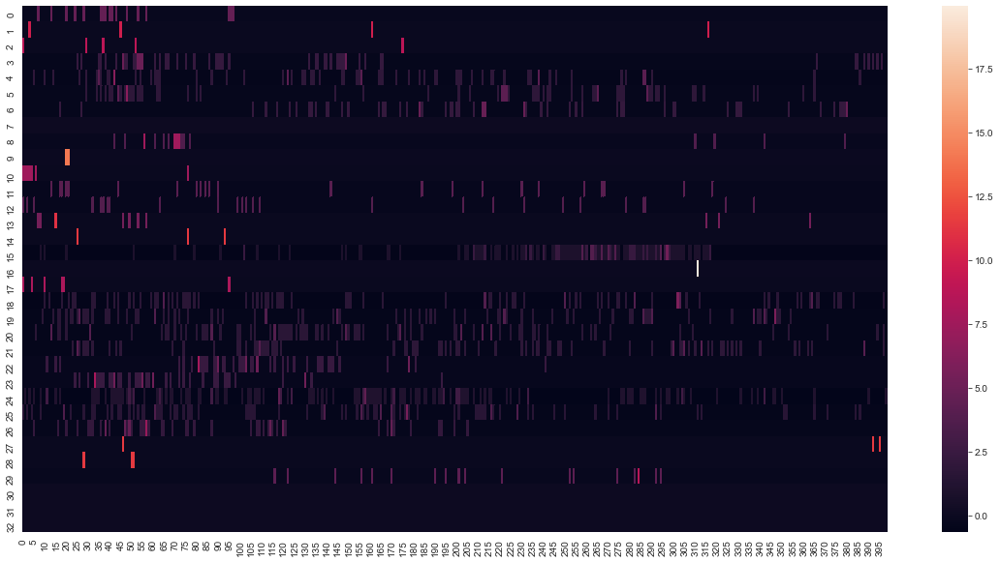

...

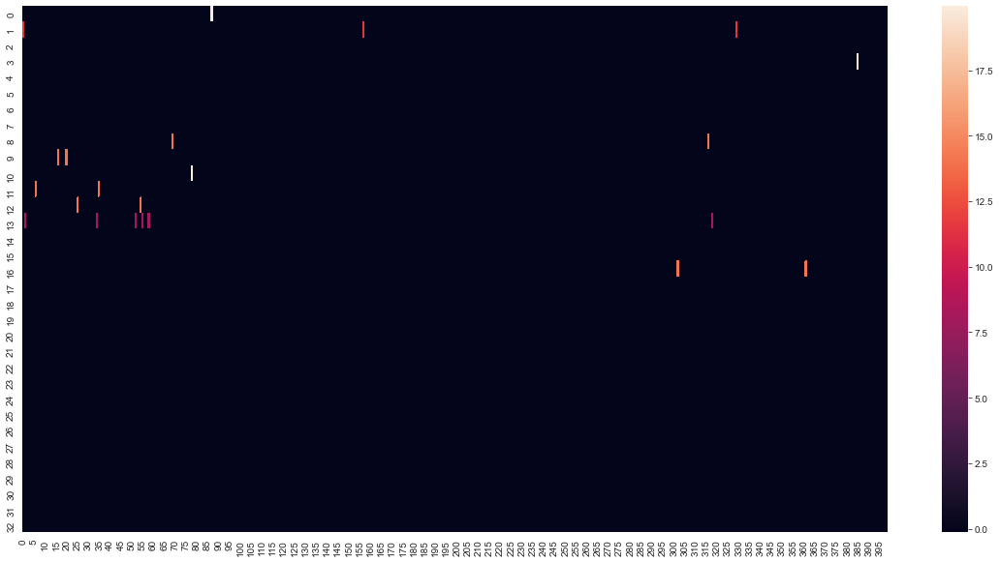

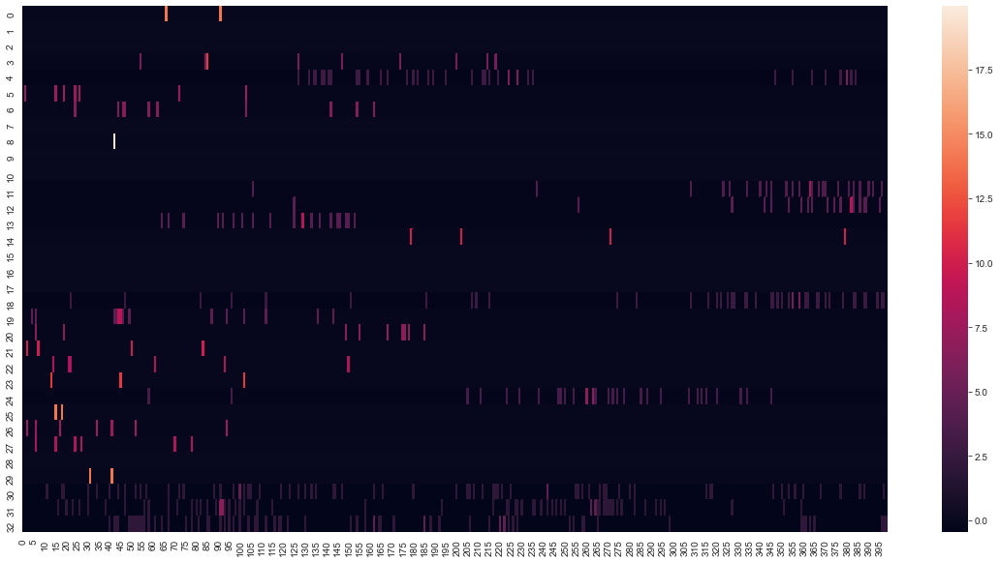

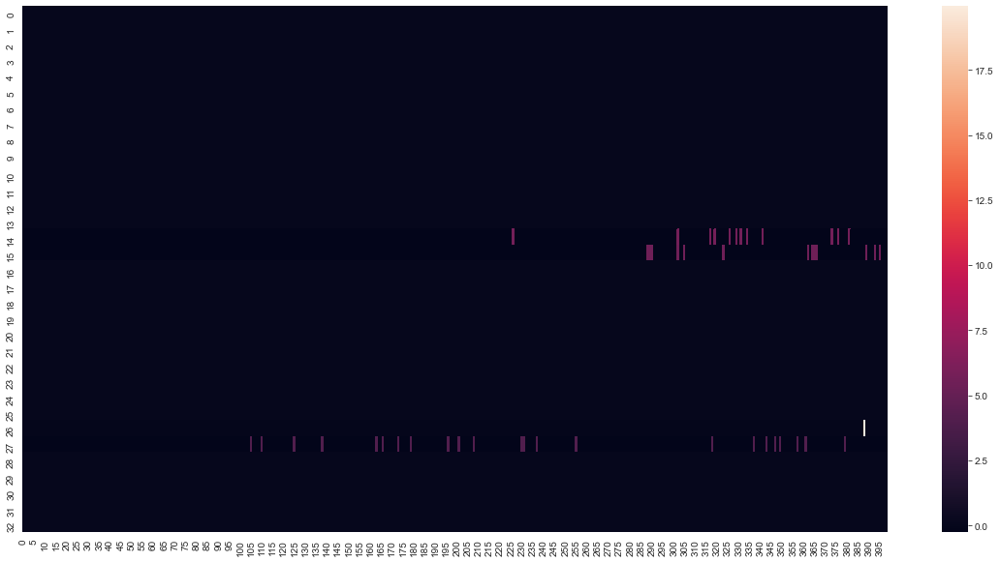

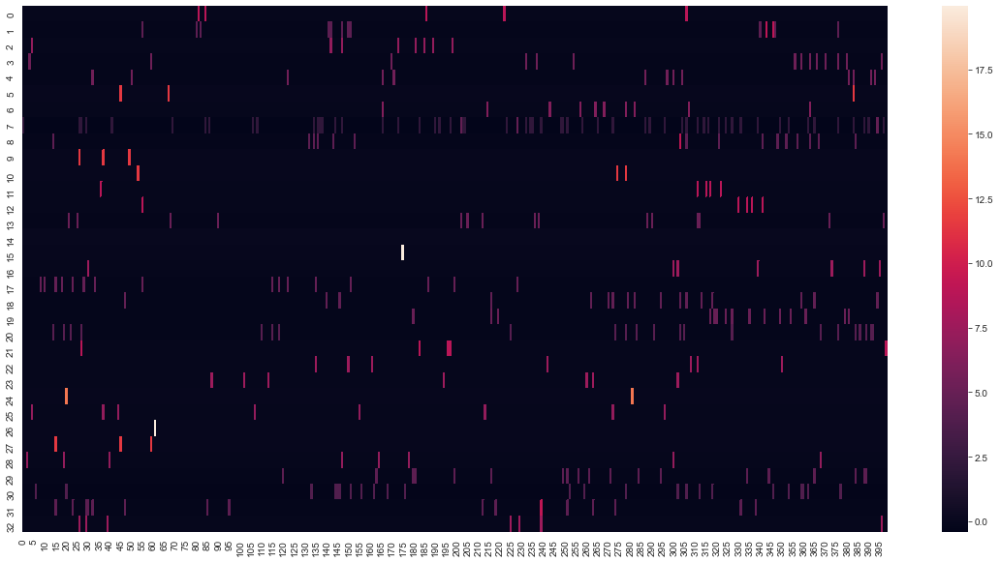

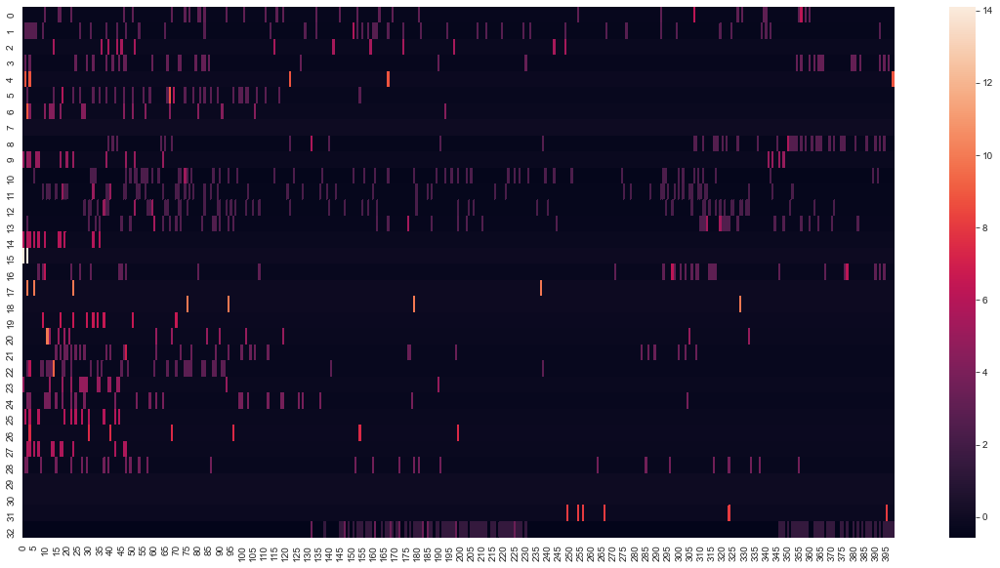

In [43]:
#failure
for i,trial in enumerate(alltrials):
    fig, ax = plt.subplots(figsize=(20, 10))
    sns.heatmap(trial)
    plt.show()
    #fig.savefig(save_path + '/' + str('fail')+str(i)+'.png')
    plt.close()